# Imports

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import ctypes

# Accès et chargement de la librairie (C++)

In [2]:
path_to_shared_library = "../library/cmake-build-debug/liblibrary"

if __name__ == "__main__":
    my_lib = ctypes.CDLL(path_to_shared_library)

# I) Première Catégorie : Classification

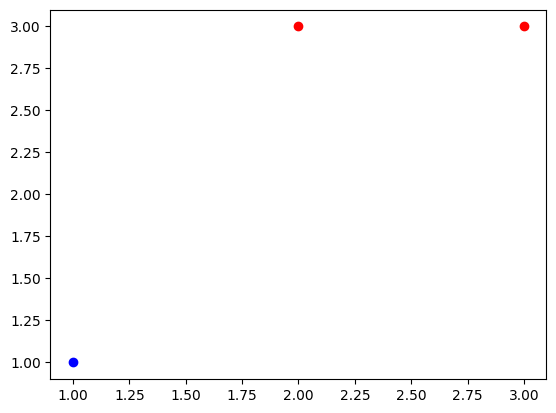

In [3]:
X = np.array([[1, 1], [2, 3], [3, 3]])
Y = np.array([1, -1, -1])

plt.scatter(X[0, 0], X[0, 1], color='blue')
plt.scatter(X[1:3,0], X[1:3,1], color='red')
plt.show()
plt.clf()

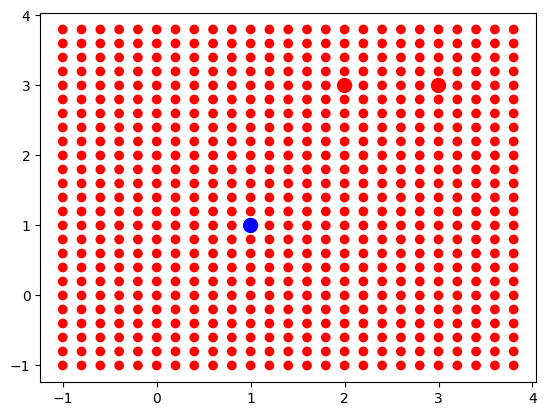

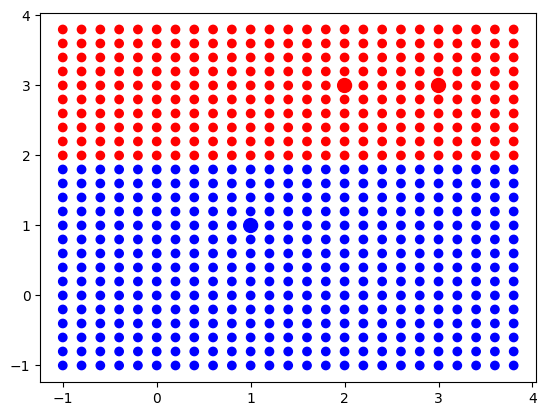

In [4]:
# Dataset inputs
X = np.array([[1, 1], [2, 3], [3, 3]])

# Dataset outputs
Y = np.array([1, -1, -1])

arr = [2, 1]
arr_size = len(arr)
arr_type = ctypes.c_int * arr_size

my_lib.create_mlp_model.argtypes = [arr_type, ctypes.c_int]
my_lib.create_mlp_model.restype = ctypes.c_void_p

native_arr = arr_type(*arr)

# Creation of the MLP model
model = my_lib.create_mlp_model(native_arr, arr_size)

dataset_inputs = X.tolist()

result = []

for sublist in dataset_inputs:
    for item in sublist:
        result.append(item)

dataset_inputs = result
dataset_expected_outputs = Y.tolist()

dataset_inputs_size = len(dataset_inputs)
dataset_expected_outputs_size = len(dataset_expected_outputs)

test_model = []

for i in range(-5, 20):
    for j in range(-5, 20):
        test_model.append([i / 5, j / 5])

predicted_values = []

for idx in test_model:

    idx_size = len(idx)
    idx_type = ctypes.c_float * idx_size

    my_lib.predict_mlp_model_classification.argtypes = [ctypes.c_void_p, idx_type, ctypes.c_int]
    my_lib.predict_mlp_model_classification.restype = ctypes.POINTER(ctypes.c_float)

    native_idx = idx_type(*idx)

    predict = my_lib.predict_mlp_model_classification(model, native_idx, idx_size)

    predicted_values.append(predict[0])

predicted_values = []

for idx in test_model:
    idx_size = len(idx)
    idx_type = ctypes.c_float * idx_size

    my_lib.predict_mlp_model_classification.argtypes = [ctypes.c_void_p, idx_type, ctypes.c_int]
    my_lib.predict_mlp_model_classification.restype = ctypes.POINTER(ctypes.c_float)

    native_idx = idx_type(*idx)

    predict = my_lib.predict_mlp_model_classification(model, native_idx, idx_size)

    predicted_values.append(predict[0])

plt.scatter([p[0] for p in test_model], [p[1] for p in test_model],
            c=['blue' if predicted >= 0 else 'red' for predicted in predicted_values])
plt.scatter([p[0] for p in X], [p[1] for p in X],
            c=["blue" if expected_output >= 0 else "red" for expected_output in dataset_expected_outputs], s=100)
plt.show()

dataset_inputs_type = ctypes.c_float * dataset_inputs_size
dataset_outputs_type = ctypes.c_float * dataset_expected_outputs_size

my_lib.train_classification_stochastic_backprop_mlp_model.argtypes = [ctypes.c_void_p, dataset_inputs_type,
                                                                      ctypes.c_int,
                                                                      dataset_outputs_type, ctypes.c_int,
                                                                      ctypes.c_float,
                                                                      ctypes.c_int]

my_lib.train_classification_stochastic_backprop_mlp_model.restype = None

inputs_native = dataset_inputs_type(*dataset_inputs)
outputs_native = dataset_outputs_type(*dataset_expected_outputs)

my_lib.train_classification_stochastic_backprop_mlp_model(model, inputs_native, dataset_inputs_size, outputs_native,
                                                          dataset_expected_outputs_size, 0.001, 100000)

predicted_values = []

for idx in test_model:
    idx_size = len(idx)
    idx_type = ctypes.c_float * idx_size

    my_lib.predict_mlp_model_classification.argtypes = [ctypes.c_void_p, idx_type, ctypes.c_int]
    my_lib.predict_mlp_model_classification.restype = ctypes.POINTER(ctypes.c_float)

    native_idx = idx_type(*idx)

    predict = my_lib.predict_mlp_model_classification(model, native_idx, idx_size)

    predicted_values.append(predict[0])

plt.scatter([p[0] for p in test_model], [p[1] for p in test_model],
            c=['blue' if predicted >= 0 else 'red' for predicted in predicted_values])
plt.scatter([p[0] for p in X], [p[1] for p in X],
            c=["blue" if expected_output >= 0 else "red" for expected_output in dataset_expected_outputs], s=100)
plt.show()

my_lib.destroy_mlp_model.argtypes = [ctypes.c_void_p]
my_lib.destroy_mlp_model.restype = None

my_lib.destroy_mlp_model(model)  # Model erase

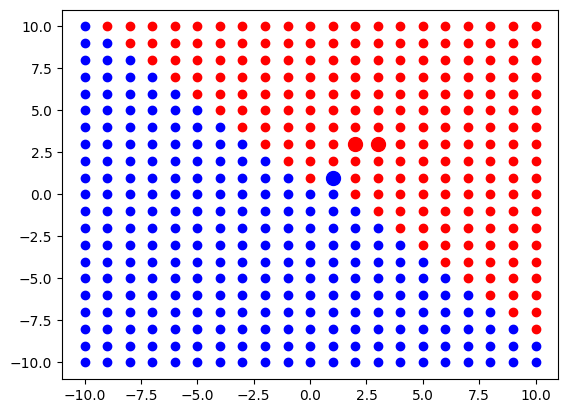

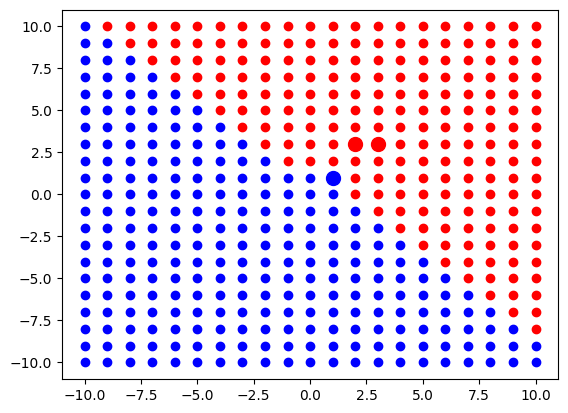

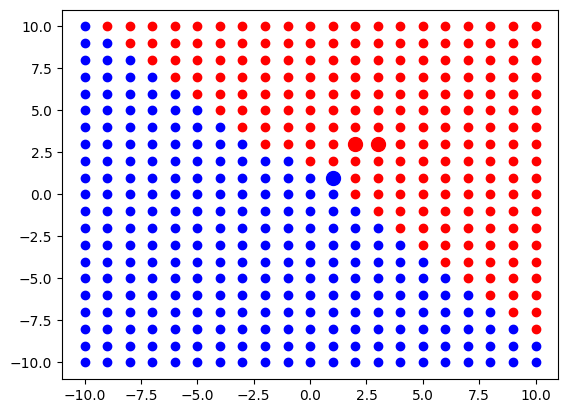

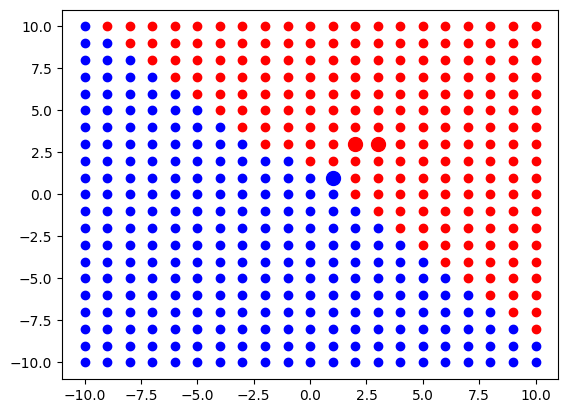

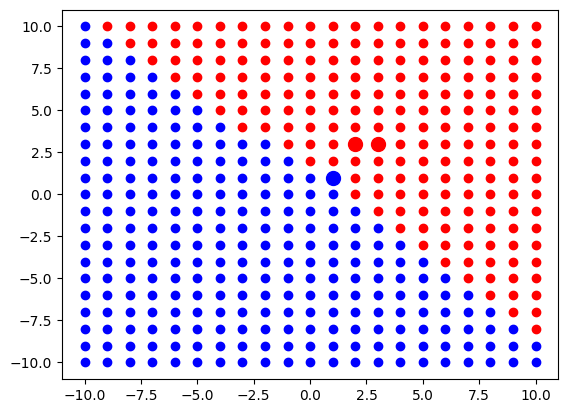

...

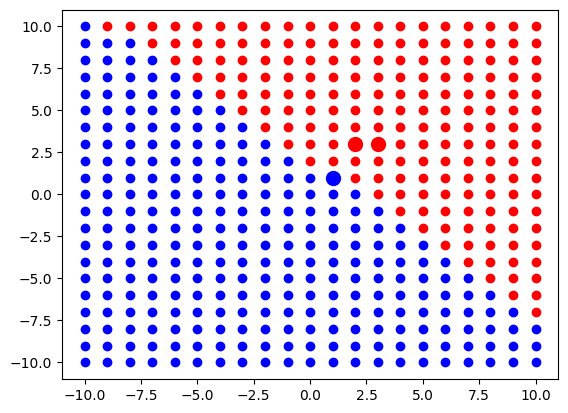

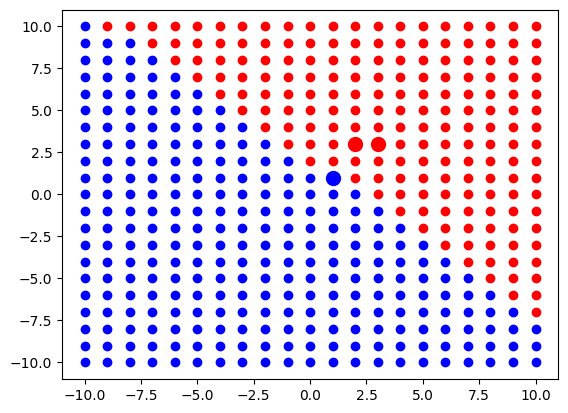

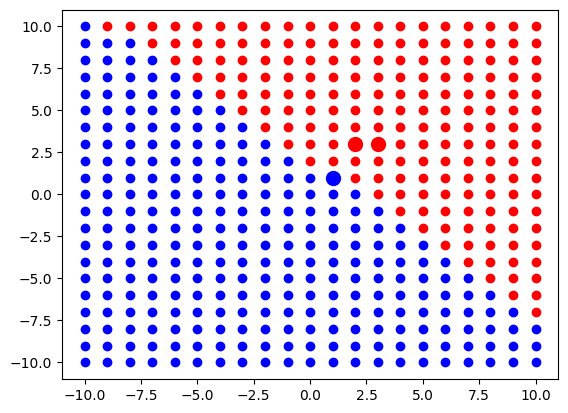

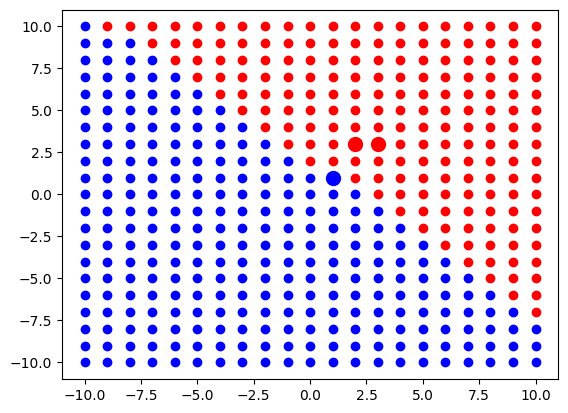

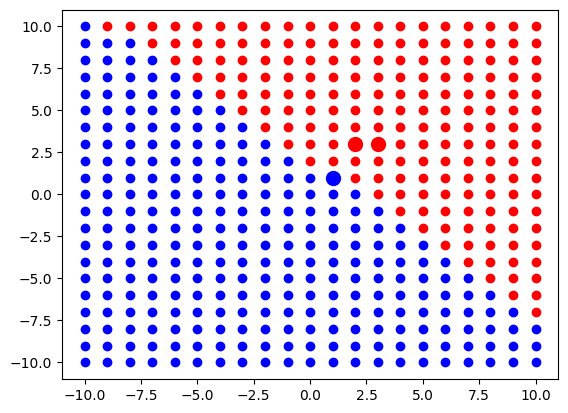

In [5]:
# Dataset inputs
X = np.array([[1, 1], [2, 3], [3, 3]])

# Dataset outputs
Y = np.array([1, -1, -1])

dataset_inputs = X.tolist()
dataset_expected_outputs = Y.tolist()

result = []

for sublist in dataset_inputs:
    for item in sublist:
        result.append(item)

dataset_inputs = result

dataset_inputs_size = len(dataset_inputs)
dataset_expected_outputs_size = len(dataset_expected_outputs)

dim = 2

initiate_model = [0.0] * dim
initiate_model_size = len(initiate_model)
initiate_model_type = ctypes.c_float * initiate_model_size

my_lib.create_linear_model.argtypes = [initiate_model_type, ctypes.c_int]
my_lib.create_linear_model.restype = ctypes.POINTER(ctypes.c_float)

native_initiate_model = initiate_model_type(*initiate_model)

model = my_lib.create_linear_model(native_initiate_model, initiate_model_size)

final_size = dim + 1

tab_model = []

for a in range(final_size):
    tab_model.append(model[a])

tab_model_size = len(tab_model)
tab_model_type = ctypes.c_float * tab_model_size

native_tab_model = tab_model_type(*tab_model)

for _ in range(100):
    points_x1_blue = []
    points_x2_blue = []

    points_x1_red = []
    points_x2_red = []

    for i in range(-10, 11):
        for j in range(-10, 11):

            tab_index = []

            tab_index.append(i)
            tab_index.append(j)

            tab_index_size = len(tab_index)
            tab_index_type = ctypes.c_float * tab_index_size

            my_lib.predict_linear_model_classification.argtypes = [tab_model_type, ctypes.c_int, tab_index_type,
                                                                   ctypes.c_int]

            my_lib.predict_linear_model_classification.restype = ctypes.c_float

            native_tab_index = tab_index_type(*tab_index)

            if my_lib.predict_linear_model_classification(native_tab_model, tab_model_size, native_tab_index,
                                                             dataset_inputs_size) > 0.0:
                points_x1_blue.append(i)
                points_x2_blue.append(j)

            else:
                points_x1_red.append(i)
                points_x2_red.append(j)

    plt.scatter(points_x1_blue, points_x2_blue, c='blue')
    plt.scatter(points_x1_red, points_x2_red, c='red')

    plt.scatter([X[p][0] for p in range(len(Y)) if Y[p] > 0], [X[p][1] for p in range(len(Y)) if Y[p] > 0],
                c='blue', s=100)
    plt.scatter([X[p][0] for p in range(len(Y)) if Y[p] < 0], [X[p][1] for p in range(len(Y)) if Y[p] < 0],
                c='red', s=100)

    plt.show()
    plt.clf()

    dataset_inputs_for_train = []

    for elt in X:

        dataset_inputs_for_train.append(elt[0])
        dataset_inputs_for_train.append(elt[1])

    dataset_inputs_type = ctypes.c_float * dataset_inputs_size
    dataset_outputs_type = ctypes.c_float * dataset_expected_outputs_size

    my_lib.train_rosenblatt_linear_model.argtypes = [tab_model_type, ctypes.c_int, dataset_inputs_type,
                                                     ctypes.c_int, dataset_outputs_type, ctypes.c_int, ctypes.c_int,
                                                     ctypes.c_float]

    my_lib.train_rosenblatt_linear_model.restype = None

    native_dataset_inputs = dataset_inputs_type(*dataset_inputs)
    native_dataset_outputs = dataset_outputs_type(*dataset_expected_outputs)

    my_lib.train_rosenblatt_linear_model(native_tab_model, tab_model_size, native_dataset_inputs,
                                         dataset_inputs_size, native_dataset_outputs, dataset_expected_outputs_size,
                                         20, 0.001)

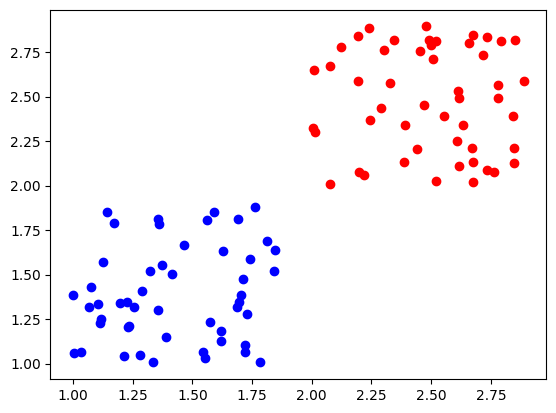

In [6]:
X = np.concatenate([np.random.random((50,2)) * 0.9 + np.array([1, 1]), np.random.random((50,2)) * 0.9 + np.array([2, 2])])
Y = np.concatenate([np.ones((50, 1)), np.ones((50, 1)) * -1.0])

plt.scatter(X[0:50, 0], X[0:50, 1], color='blue')
plt.scatter(X[50:100,0], X[50:100,1], color='red')
plt.show()
plt.clf()

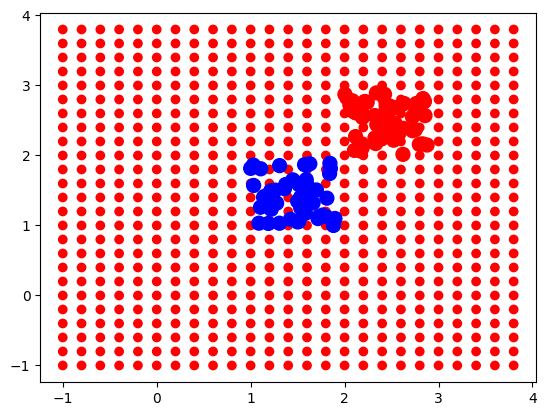

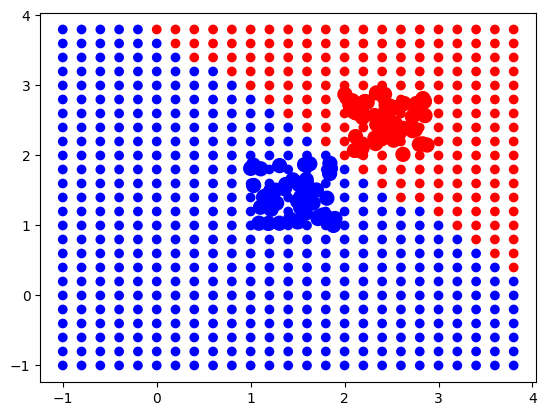

In [7]:
# Dataset inputs
X = np.concatenate([np.random.random((50,2)) * 0.9 + np.array([1, 1]), np.random.random((50,2)) * 0.9 + np.array([2, 2])])

# Dataset outputs
Y = np.concatenate([np.ones((50, 1)), np.ones((50, 1)) * -1.0])

arr = [2, 1]
arr_size = len(arr)
arr_type = ctypes.c_int * arr_size

my_lib.create_mlp_model.argtypes = [arr_type, ctypes.c_int]
my_lib.create_mlp_model.restype = ctypes.c_void_p

native_arr = arr_type(*arr)

# Creation of the MLP model
model = my_lib.create_mlp_model(native_arr, arr_size)

dataset_inputs = X.tolist()
dataset_expected_outputs = Y

result = []

for sublist in dataset_inputs:
    for item in sublist:
        result.append(item)

dataset_inputs = result

dataset_inputs_size = len(dataset_inputs)
dataset_expected_outputs_size = len(dataset_expected_outputs)

test_model = []

for i in range(-5, 20):
    for j in range(-5, 20):
        test_model.append([i / 5, j / 5])

predicted_values = []

for idx in test_model:

    idx_size = len(idx)
    idx_type = ctypes.c_float * idx_size

    my_lib.predict_mlp_model_classification.argtypes = [ctypes.c_void_p, idx_type, ctypes.c_int]
    my_lib.predict_mlp_model_classification.restype = ctypes.POINTER(ctypes.c_float)

    native_idx = idx_type(*idx)

    predict = my_lib.predict_mlp_model_classification(model, native_idx, idx_size)

    predicted_values.append(predict[0])

predicted_values = []

for idx in test_model:
    idx_size = len(idx)
    idx_type = ctypes.c_float * idx_size

    my_lib.predict_mlp_model_classification.argtypes = [ctypes.c_void_p, idx_type, ctypes.c_int]
    my_lib.predict_mlp_model_classification.restype = ctypes.POINTER(ctypes.c_float)

    native_idx = idx_type(*idx)

    predict = my_lib.predict_mlp_model_classification(model, native_idx, idx_size)

    predicted_values.append(predict[0])

plt.scatter([p[0] for p in test_model], [p[1] for p in test_model],
            c=['blue' if predicted >= 0 else 'red' for predicted in predicted_values])
plt.scatter([p[0] for p in X], [p[1] for p in X],
            c=["blue" if expected_output >= 0 else "red" for expected_output in dataset_expected_outputs], s=100)
plt.show()

dataset_inputs_type = ctypes.c_float * dataset_inputs_size
dataset_outputs_type = ctypes.c_float * dataset_expected_outputs_size

my_lib.train_classification_stochastic_backprop_mlp_model.argtypes = [ctypes.c_void_p, dataset_inputs_type,
                                                                      ctypes.c_int,
                                                                      dataset_outputs_type, ctypes.c_int,
                                                                      ctypes.c_float,
                                                                      ctypes.c_int]

my_lib.train_classification_stochastic_backprop_mlp_model.restype = None

native_dataset_inputs = dataset_inputs_type(*dataset_inputs)
native_dataset_outputs = dataset_outputs_type(*dataset_expected_outputs)

my_lib.train_classification_stochastic_backprop_mlp_model(model, native_dataset_inputs, dataset_inputs_size,
                                                          native_dataset_outputs,
                                                          dataset_expected_outputs_size, 0.001, 100000)

predicted_values = []

for idx in test_model:
    idx_size = len(idx)
    idx_type = ctypes.c_float * idx_size

    my_lib.predict_mlp_model_classification.argtypes = [ctypes.c_void_p, idx_type, ctypes.c_int]
    my_lib.predict_mlp_model_classification.restype = ctypes.POINTER(ctypes.c_float)

    native_idx = idx_type(*idx)

    predict = my_lib.predict_mlp_model_classification(model, native_idx, idx_size)

    predicted_values.append(predict[0])

plt.scatter([p[0] for p in test_model], [p[1] for p in test_model],
            c=['blue' if predicted >= 0 else 'red' for predicted in predicted_values])
plt.scatter([p[0] for p in X], [p[1] for p in X],
            c=["blue" if expected_output >= 0 else "red" for expected_output in dataset_expected_outputs], s=100)
plt.show()

my_lib.destroy_mlp_model.argtypes = [ctypes.c_void_p]
my_lib.destroy_mlp_model.restype = None

my_lib.destroy_mlp_model(model)  # Model erase

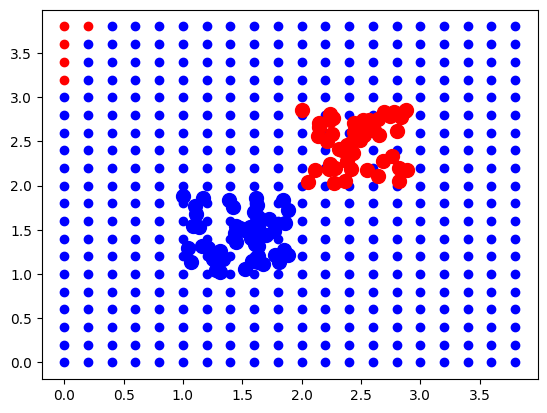

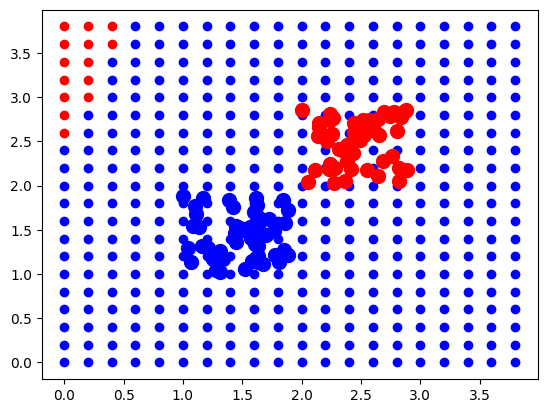

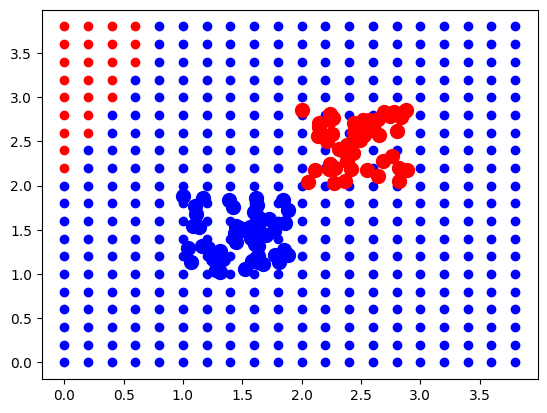

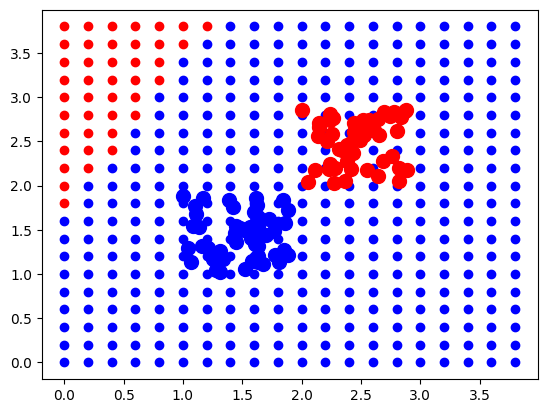

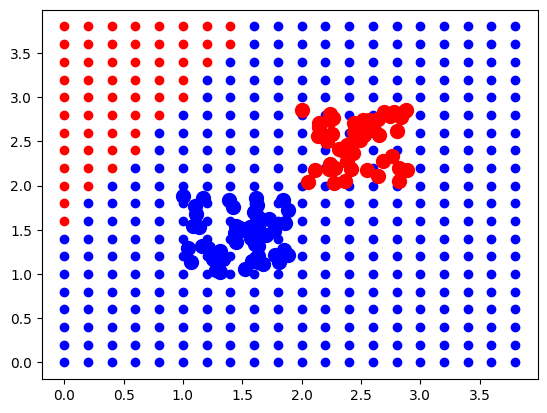

...

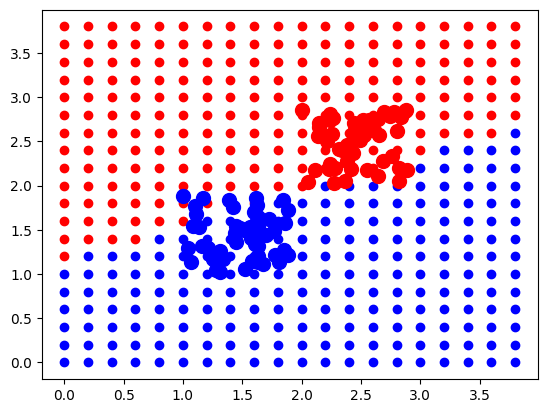

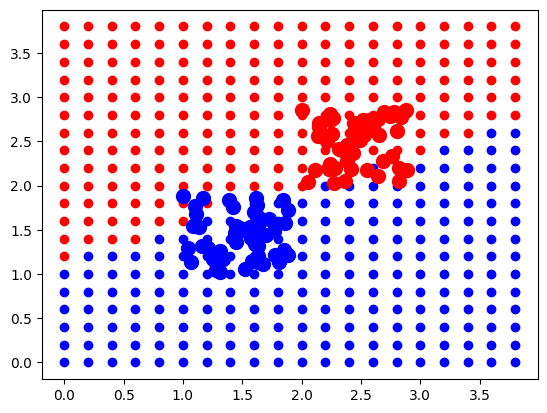

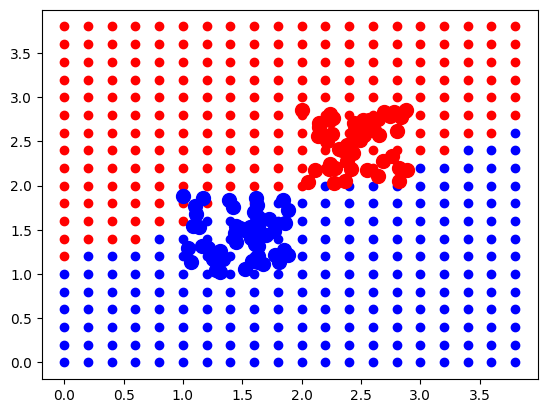

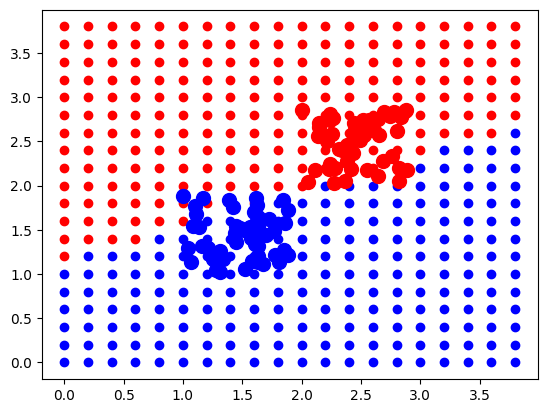

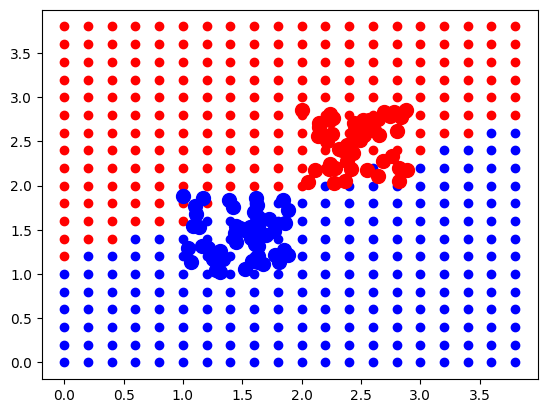

In [8]:
# Dataset inputs
X = np.concatenate([np.random.random((50,2)) * 0.9 + np.array([1, 1]), np.random.random((50,2)) * 0.9 + np.array([2, 2])])

# Dataset outputs
Y = np.concatenate([np.ones((50, 1)), np.ones((50, 1)) * -1.0])

dataset_inputs = X.tolist()
dataset_expected_outputs = Y

result = []

for sublist in dataset_inputs:
    for item in sublist:
        result.append(item)

dataset_inputs = result

dataset_inputs_size = len(dataset_inputs)
dataset_expected_outputs_size = len(dataset_expected_outputs)

dim = 2

initiate_model = [0.0] * dim
initiate_model_size = len(initiate_model)
initiate_model_type = ctypes.c_float * initiate_model_size

my_lib.create_linear_model.argtypes = [initiate_model_type, ctypes.c_int]
my_lib.create_linear_model.restype = ctypes.POINTER(ctypes.c_float)

native_initiate_model = initiate_model_type(*initiate_model)

model = my_lib.create_linear_model(native_initiate_model, initiate_model_size)

final_size = dim + 1

tab_model = []

for a in range(final_size):
    tab_model.append(model[a])

tab_model_size = len(tab_model)
tab_model_type = ctypes.c_float * tab_model_size

native_tab_model = tab_model_type(*tab_model)

for _ in range(100):
    points_x1_blue = []
    points_x2_blue = []

    points_x1_red = []
    points_x2_red = []

    for i in np.arange(0.0, 4.0, 0.2):
        for j in np.arange(0.0, 4.0, 0.2):

            tab_index = []

            tab_index.append(i)
            tab_index.append(j)

            tab_index_size = len(tab_index)
            tab_index_type = ctypes.c_float * tab_index_size

            my_lib.predict_linear_model_classification.argtypes = [tab_model_type, ctypes.c_int, tab_index_type,
                                                                   ctypes.c_int]

            my_lib.predict_linear_model_classification.restype = ctypes.c_float

            native_tab_index = tab_index_type(*tab_index)

            if my_lib.predict_linear_model_classification(native_tab_model, tab_model_size, native_tab_index,
                                                             dataset_inputs_size) > 0.0:
                points_x1_blue.append(i)
                points_x2_blue.append(j)

            else:
                points_x1_red.append(i)
                points_x2_red.append(j)

    plt.scatter(points_x1_blue, points_x2_blue, c='blue')
    plt.scatter(points_x1_red, points_x2_red, c='red')

    plt.scatter([X[p][0] for p in range(len(Y)) if Y[p] > 0], [X[p][1] for p in range(len(Y)) if Y[p] > 0],
                c='blue', s=100)
    plt.scatter([X[p][0] for p in range(len(Y)) if Y[p] < 0], [X[p][1] for p in range(len(Y)) if Y[p] < 0],
                c='red', s=100)

    plt.show()
    plt.clf()

    dataset_inputs_for_train = []

    for elt in X:

        dataset_inputs_for_train.append(elt[0])
        dataset_inputs_for_train.append(elt[1])

    dataset_inputs_type = ctypes.c_float * dataset_inputs_size
    dataset_outputs_type = ctypes.c_float * dataset_expected_outputs_size

    my_lib.train_rosenblatt_linear_model.argtypes = [tab_model_type, ctypes.c_int, dataset_inputs_type,
                                                     ctypes.c_int, dataset_outputs_type, ctypes.c_int, ctypes.c_int,
                                                     ctypes.c_float]

    my_lib.train_rosenblatt_linear_model.restype = None

    native_dataset_inputs = dataset_inputs_type(*dataset_inputs)
    native_dataset_outputs = dataset_outputs_type(*dataset_expected_outputs)

    my_lib.train_rosenblatt_linear_model(native_tab_model, tab_model_size, native_dataset_inputs,
                                         dataset_inputs_size, native_dataset_outputs, dataset_expected_outputs_size,
                                         20, 0.001)

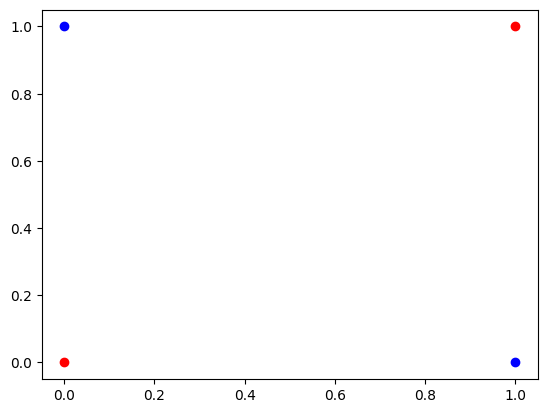

In [9]:
X = np.array([[1, 0], [0, 1], [0, 0], [1, 1]])
Y = np.array([1, 1, -1, -1])

plt.scatter(X[0:2, 0], X[0:2, 1], color='blue')
plt.scatter(X[2:4,0], X[2:4,1], color='red')
plt.show()
plt.clf()

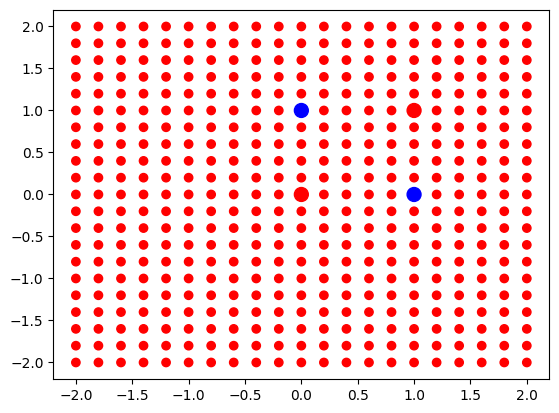

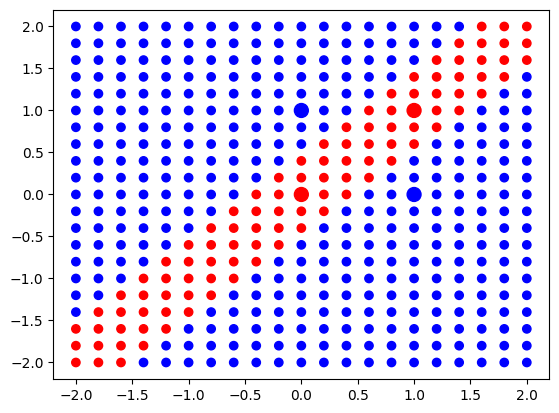

In [10]:
# Dataset inputs
X = np.array([[1, 0], [0, 1], [0, 0], [1, 1]])

# Dataset outputs
Y = np.array([1, 1, -1, -1])

arr = [2, 2, 1]
arr_size = len(arr)
arr_type = ctypes.c_int * arr_size

my_lib.create_mlp_model.argtypes = [arr_type, ctypes.c_int]
my_lib.create_mlp_model.restype = ctypes.c_void_p

native_arr = arr_type(*arr)

# Creation of the MLP model
model = my_lib.create_mlp_model(native_arr, arr_size)

dataset_inputs = X.tolist()
dataset_expected_outputs = Y

result = []

for sublist in dataset_inputs:
    for item in sublist:
        result.append(item)

dataset_inputs = result

dataset_inputs_size = len(dataset_inputs)
dataset_expected_outputs_size = len(dataset_expected_outputs)

test_model = []

for i in range(-10, 11):
    for j in range(-10, 11):
        test_model.append([i / 5, j /5])

predicted_values = []

for idx in test_model:

    idx_size = len(idx)
    idx_type = ctypes.c_float * idx_size

    my_lib.predict_mlp_model_classification.argtypes = [ctypes.c_void_p, idx_type, ctypes.c_int]
    my_lib.predict_mlp_model_classification.restype = ctypes.POINTER(ctypes.c_float)

    native_idx = idx_type(*idx)

    predict = my_lib.predict_mlp_model_classification(model, native_idx, idx_size)

    predicted_values.append(predict[0])

predicted_values = []

for idx in test_model:
    idx_size = len(idx)
    idx_type = ctypes.c_float * idx_size

    my_lib.predict_mlp_model_classification.argtypes = [ctypes.c_void_p, idx_type, ctypes.c_int]
    my_lib.predict_mlp_model_classification.restype = ctypes.POINTER(ctypes.c_float)

    native_idx = idx_type(*idx)

    predict = my_lib.predict_mlp_model_classification(model, native_idx, idx_size)

    predicted_values.append(predict[0])

plt.scatter([p[0] for p in test_model], [p[1] for p in test_model],
            c=['blue' if predicted >= 0 else 'red' for predicted in predicted_values])
plt.scatter([p[0] for p in X], [p[1] for p in X],
            c=["blue" if expected_output >= 0 else "red" for expected_output in dataset_expected_outputs], s=100)
plt.show()

dataset_inputs_for_train = []

for elt in X:
    dataset_inputs_for_train.append(elt[0])
    dataset_inputs_for_train.append(elt[1])

dataset_inputs_for_train_size = len(dataset_inputs_for_train)

dataset_inputs_type = ctypes.c_float * dataset_inputs_for_train_size
dataset_outputs_type = ctypes.c_float * dataset_expected_outputs_size

my_lib.train_classification_stochastic_backprop_mlp_model.argtypes = [ctypes.c_void_p, dataset_inputs_type,
                                                                      ctypes.c_int,
                                                                      dataset_outputs_type, ctypes.c_int,
                                                                      ctypes.c_float,
                                                                      ctypes.c_int]

my_lib.train_classification_stochastic_backprop_mlp_model.restype = None

native_dataset_inputs = dataset_inputs_type(*dataset_inputs_for_train)
native_dataset_outputs = dataset_outputs_type(*dataset_expected_outputs)

my_lib.train_classification_stochastic_backprop_mlp_model(model, native_dataset_inputs,
                                                          dataset_inputs_for_train_size,
                                                          native_dataset_outputs,
                                                          dataset_expected_outputs_size, 0.001, 100000)

predicted_values = []

for idx in test_model:
    
    idx_size = len(idx)
    idx_type = ctypes.c_float * idx_size

    my_lib.predict_mlp_model_classification.argtypes = [ctypes.c_void_p, idx_type, ctypes.c_int]
    my_lib.predict_mlp_model_classification.restype = ctypes.POINTER(ctypes.c_float)

    native_idx = idx_type(*idx)

    predict = my_lib.predict_mlp_model_classification(model, native_idx, idx_size)

    predicted_values.append(predict[0])

plt.scatter([p[0] for p in test_model], [p[1] for p in test_model],
            c=['blue' if predicted >= 0 else 'red' for predicted in predicted_values])
plt.scatter([p[0] for p in X], [p[1] for p in X],
            c=["blue" if expected_output >= 0 else "red" for expected_output in dataset_expected_outputs], s=100)
plt.show()

my_lib.destroy_mlp_model.argtypes = [ctypes.c_void_p]
my_lib.destroy_mlp_model.restype = None

my_lib.destroy_mlp_model(model)  # Model erase

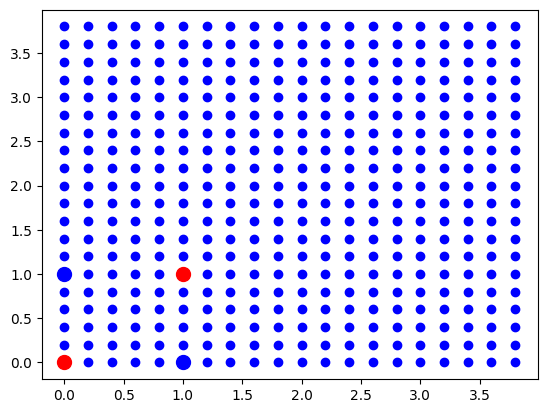

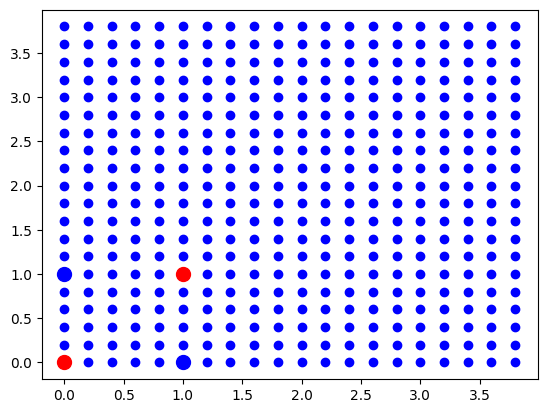

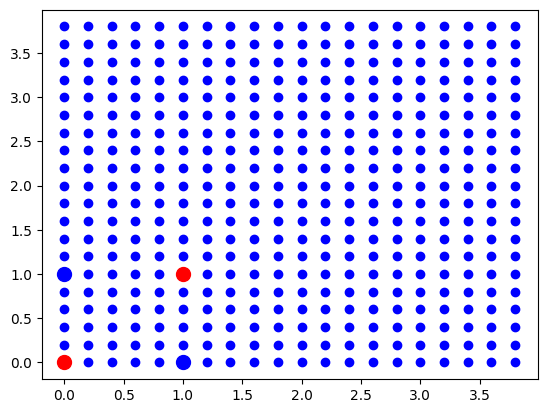

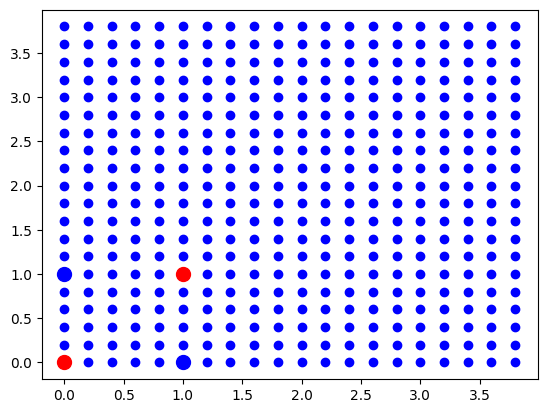

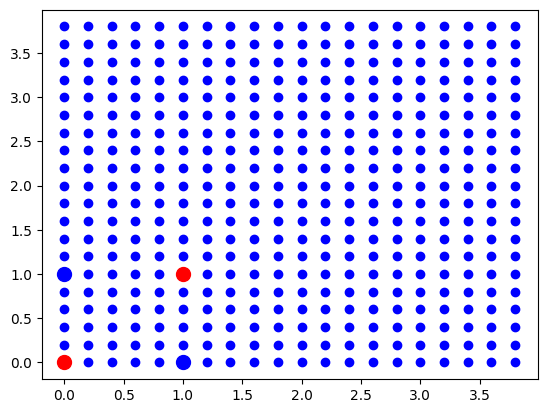

...

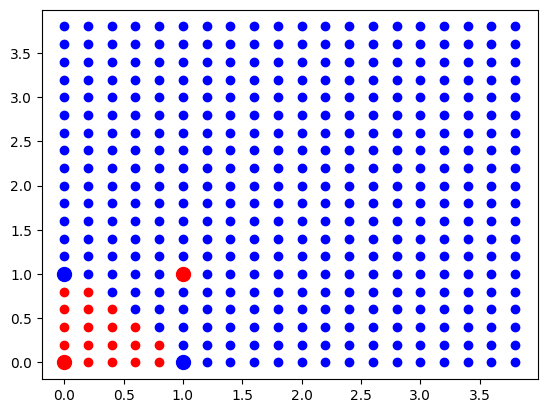

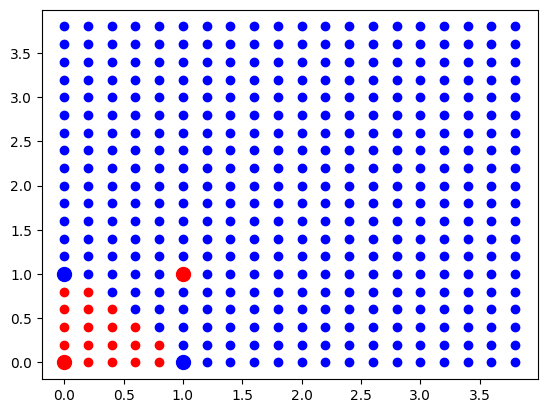

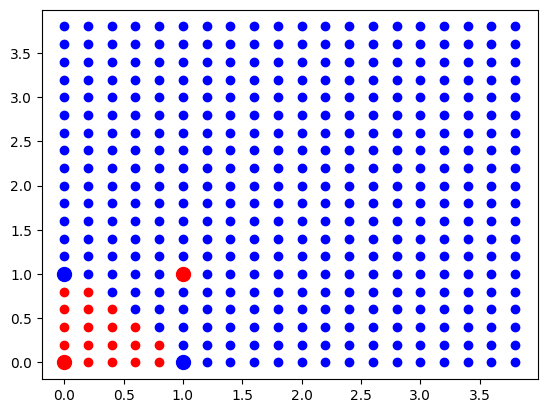

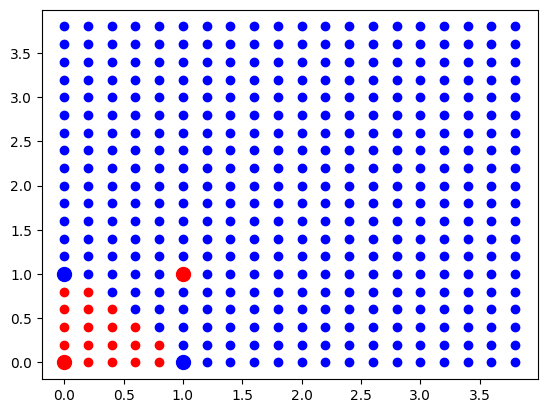

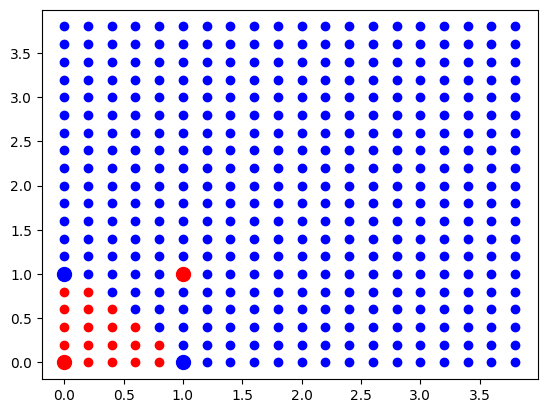

In [11]:
# Dataset inputs
X = np.array([[1, 0], [0, 1], [0, 0], [1, 1]])

# Dataset outputs
Y = np.array([1, 1, -1, -1])

dataset_inputs = X.tolist()
dataset_expected_outputs = Y

result = []

for sublist in dataset_inputs:
    for item in sublist:
        result.append(item)

dataset_inputs = result

dataset_inputs_size = len(dataset_inputs)
dataset_expected_outputs_size = len(dataset_expected_outputs)

dim = 2

initiate_model = [0.0] * dim
initiate_model_size = len(initiate_model)
initiate_model_type = ctypes.c_float * initiate_model_size

my_lib.create_linear_model.argtypes = [initiate_model_type, ctypes.c_int]
my_lib.create_linear_model.restype = ctypes.POINTER(ctypes.c_float)

native_initiate_model = initiate_model_type(*initiate_model)

model = my_lib.create_linear_model(native_initiate_model, initiate_model_size)

final_size = dim + 1

tab_model = []

for a in range(final_size):
    tab_model.append(model[a])

tab_model_size = len(tab_model)
tab_model_type = ctypes.c_float * tab_model_size

native_tab_model = tab_model_type(*tab_model)

for _ in range(100):
    points_x1_blue = []
    points_x2_blue = []

    points_x1_red = []
    points_x2_red = []

    for i in np.arange(0.0, 4.0, 0.2):
        for j in np.arange(0.0, 4.0, 0.2):

            tab_index = []

            tab_index.append(i)
            tab_index.append(j)

            tab_index_size = len(tab_index)
            tab_index_type = ctypes.c_float * tab_index_size

            my_lib.predict_linear_model_classification.argtypes = [tab_model_type, ctypes.c_int, tab_index_type,
                                                                   ctypes.c_int]

            my_lib.predict_linear_model_classification.restype = ctypes.c_float

            native_tab_index = tab_index_type(*tab_index)

            if my_lib.predict_linear_model_classification(native_tab_model, tab_model_size, native_tab_index,
                                                             dataset_inputs_size) > 0.0:
                points_x1_blue.append(i)
                points_x2_blue.append(j)

            else:
                points_x1_red.append(i)
                points_x2_red.append(j)

    plt.scatter(points_x1_blue, points_x2_blue, c='blue')
    plt.scatter(points_x1_red, points_x2_red, c='red')

    plt.scatter([X[p][0] for p in range(len(Y)) if Y[p] > 0], [X[p][1] for p in range(len(Y)) if Y[p] > 0],
                c='blue', s=100)
    plt.scatter([X[p][0] for p in range(len(Y)) if Y[p] < 0], [X[p][1] for p in range(len(Y)) if Y[p] < 0],
                c='red', s=100)

    plt.show()
    plt.clf()

    dataset_inputs_for_train = []

    for elt in X:

        dataset_inputs_for_train.append(elt[0])
        dataset_inputs_for_train.append(elt[1])

    dataset_inputs_type = ctypes.c_float * dataset_inputs_size
    dataset_outputs_type = ctypes.c_float * dataset_expected_outputs_size

    my_lib.train_rosenblatt_linear_model.argtypes = [tab_model_type, ctypes.c_int, dataset_inputs_type,
                                                     ctypes.c_int, dataset_outputs_type, ctypes.c_int, ctypes.c_int,
                                                     ctypes.c_float]

    my_lib.train_rosenblatt_linear_model.restype = None

    native_dataset_inputs = dataset_inputs_type(*dataset_inputs)
    native_dataset_outputs = dataset_outputs_type(*dataset_expected_outputs)

    my_lib.train_rosenblatt_linear_model(native_tab_model, tab_model_size, native_dataset_inputs,
                                         dataset_inputs_size, native_dataset_outputs, dataset_expected_outputs_size,
                                         20, 0.001)

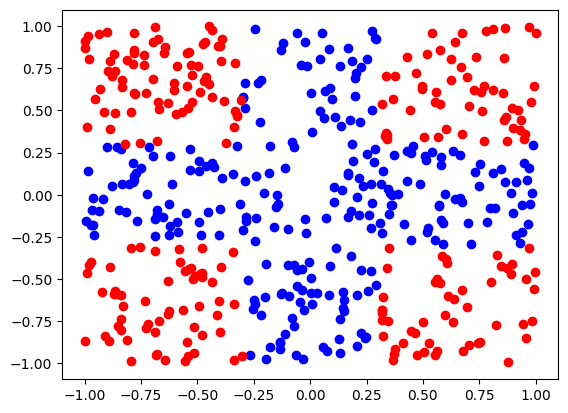

In [12]:
X = np.random.random((500, 2)) * 2.0 - 1.0
Y = np.array([1 if abs(p[0]) <= 0.3 or abs(p[1]) <= 0.3 else -1 for p in X])

plt.scatter(np.array(list(map(lambda elt : elt[1], filter(lambda c: Y[c[0]] == 1, enumerate(X)))))[:,0], np.array(list(map(lambda elt : elt[1], filter(lambda c: Y[c[0]] == 1, enumerate(X)))))[:,1], color='blue')
plt.scatter(np.array(list(map(lambda elt : elt[1], filter(lambda c: Y[c[0]] == -1, enumerate(X)))))[:,0], np.array(list(map(lambda elt : elt[1], filter(lambda c: Y[c[0]] == -1, enumerate(X)))))[:,1], color='red')
plt.show()
plt.clf()

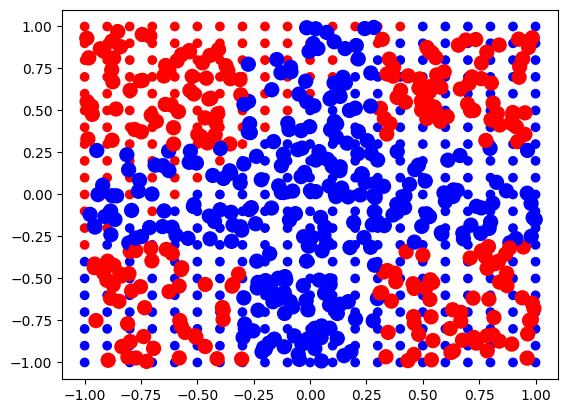

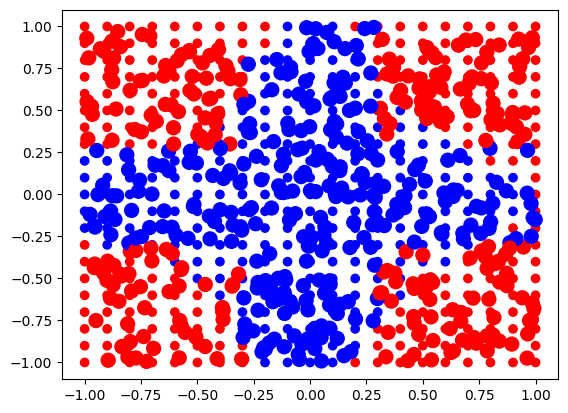

In [13]:
# Dataset inputs
X = np.random.random((500, 2)) * 2.0 - 1.0

# Dataset outputs
Y = np.array([1 if abs(p[0]) <= 0.3 or abs(p[1]) <= 0.3 else -1 for p in X])

arr = [2, 4, 1]
arr_size = len(arr)
arr_type = ctypes.c_int * arr_size

my_lib.create_mlp_model.argtypes = [arr_type, ctypes.c_int]
my_lib.create_mlp_model.restype = ctypes.c_void_p

native_arr = arr_type(*arr)

# Creation of the MLP model
model = my_lib.create_mlp_model(native_arr, arr_size)

dataset_inputs = X.tolist()
dataset_expected_outputs = Y

result = []

for sublist in dataset_inputs:
    for item in sublist:
        result.append(item)

dataset_inputs = result

dataset_inputs_size = len(dataset_inputs)
dataset_expected_outputs_size = len(dataset_expected_outputs)

test_model = []

for i in range(-10, 11):
    for j in range(-10, 11):
        test_model.append([i / 10, j / 10])

predicted_values = []

for idx in test_model:

    idx_size = len(idx)
    idx_type = ctypes.c_float * idx_size

    my_lib.predict_mlp_model_classification.argtypes = [ctypes.c_void_p, idx_type, ctypes.c_int]
    my_lib.predict_mlp_model_classification.restype = ctypes.POINTER(ctypes.c_float)

    native_idx = idx_type(*idx)

    predict = my_lib.predict_mlp_model_classification(model, native_idx, idx_size)

    predicted_values.append(predict[0])

predicted_values = []

for idx in test_model:
    idx_size = len(idx)
    idx_type = ctypes.c_float * idx_size

    my_lib.predict_mlp_model_classification.argtypes = [ctypes.c_void_p, idx_type, ctypes.c_int]
    my_lib.predict_mlp_model_classification.restype = ctypes.POINTER(ctypes.c_float)

    native_idx = idx_type(*idx)

    predict = my_lib.predict_mlp_model_classification(model, native_idx, idx_size)

    predicted_values.append(predict[0])

plt.scatter([p[0] for p in test_model], [p[1] for p in test_model],
            c=['blue' if predicted >= 0 else 'red' for predicted in predicted_values])
plt.scatter([p[0] for p in X], [p[1] for p in X],
            c=["blue" if expected_output >= 0 else "red" for expected_output in dataset_expected_outputs], s=100)
plt.show()

dataset_inputs_for_train = []

for elt in X:
    dataset_inputs_for_train.append(elt[0])
    dataset_inputs_for_train.append(elt[1])

dataset_inputs_for_train_size = len(dataset_inputs_for_train)

dataset_inputs_type = ctypes.c_float * dataset_inputs_for_train_size
dataset_outputs_type = ctypes.c_float * dataset_expected_outputs_size

my_lib.train_classification_stochastic_backprop_mlp_model.argtypes = [ctypes.c_void_p, dataset_inputs_type,
                                                                      ctypes.c_int,
                                                                      dataset_outputs_type, ctypes.c_int,
                                                                      ctypes.c_float,
                                                                      ctypes.c_int]

my_lib.train_classification_stochastic_backprop_mlp_model.restype = None

native_dataset_inputs = dataset_inputs_type(*dataset_inputs_for_train)
native_dataset_outputs = dataset_outputs_type(*dataset_expected_outputs)

my_lib.train_classification_stochastic_backprop_mlp_model(model, native_dataset_inputs,
                                                          dataset_inputs_for_train_size,
                                                          native_dataset_outputs,
                                                          dataset_expected_outputs_size, 0.001, 100000)

predicted_values = []

for idx in test_model:
    idx_size = len(idx)
    idx_type = ctypes.c_float * idx_size

    my_lib.predict_mlp_model_classification.argtypes = [ctypes.c_void_p, idx_type, ctypes.c_int]
    my_lib.predict_mlp_model_classification.restype = ctypes.POINTER(ctypes.c_float)

    native_idx = idx_type(*idx)

    predict = my_lib.predict_mlp_model_classification(model, native_idx, idx_size)

    predicted_values.append(predict[0])

plt.scatter([p[0] for p in test_model], [p[1] for p in test_model],
            c=['blue' if predicted >= 0 else 'red' for predicted in predicted_values])
plt.scatter([p[0] for p in X], [p[1] for p in X],
            c=["blue" if expected_output >= 0 else "red" for expected_output in dataset_expected_outputs], s=100)
plt.show()

my_lib.destroy_mlp_model.argtypes = [ctypes.c_void_p]
my_lib.destroy_mlp_model.restype = None

my_lib.destroy_mlp_model(model)  # Model erase

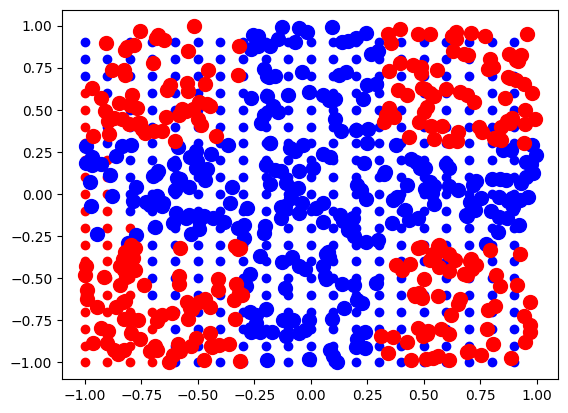

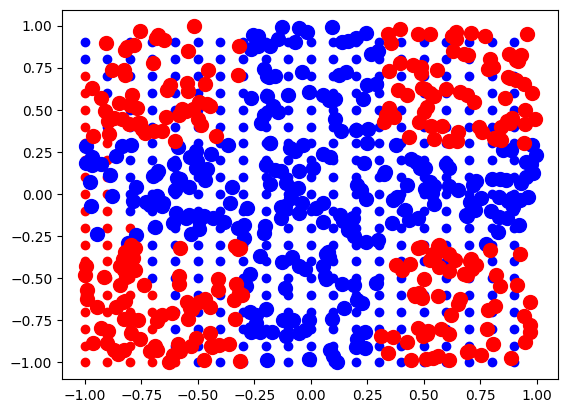

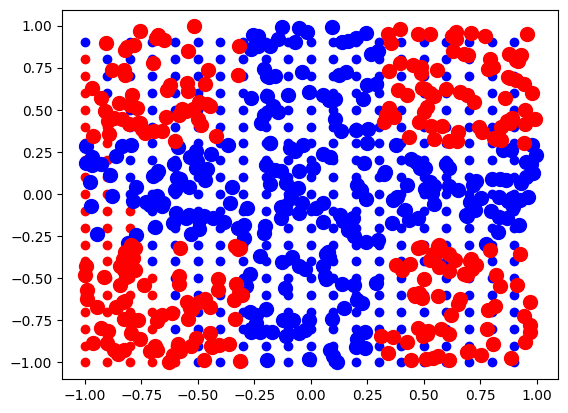

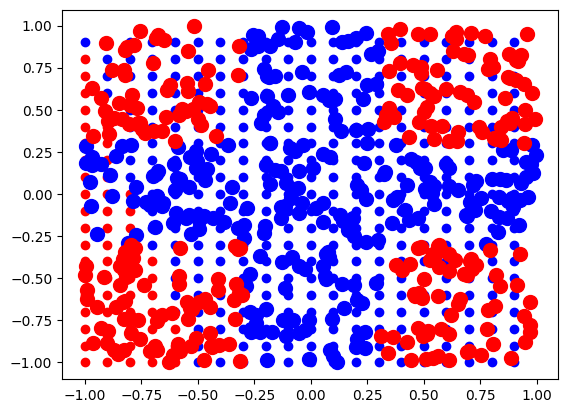

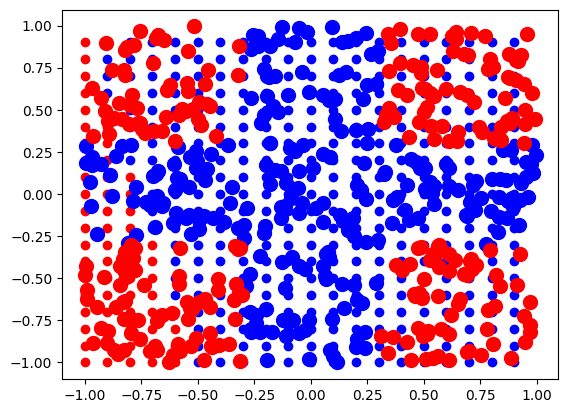

...

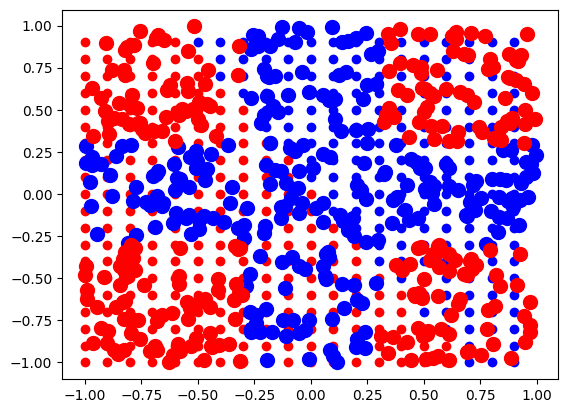

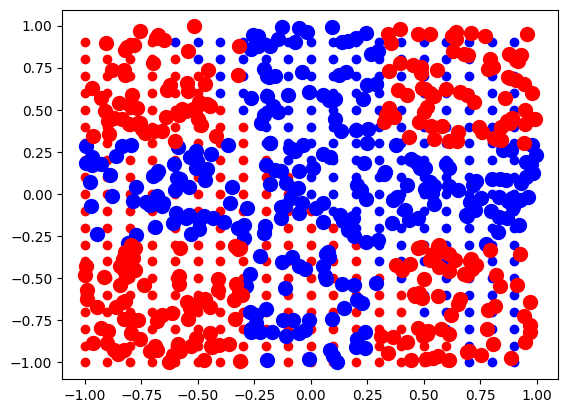

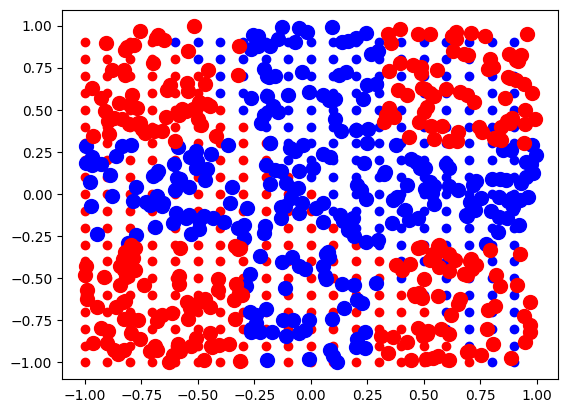

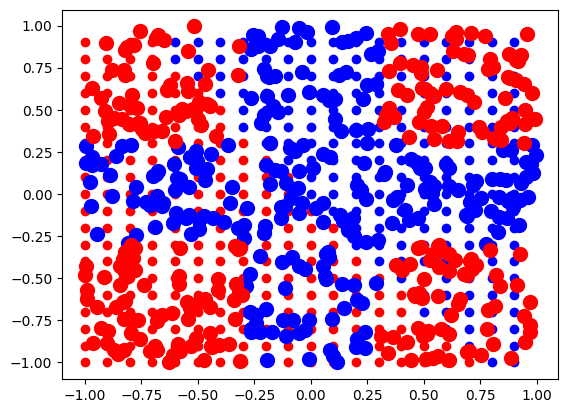

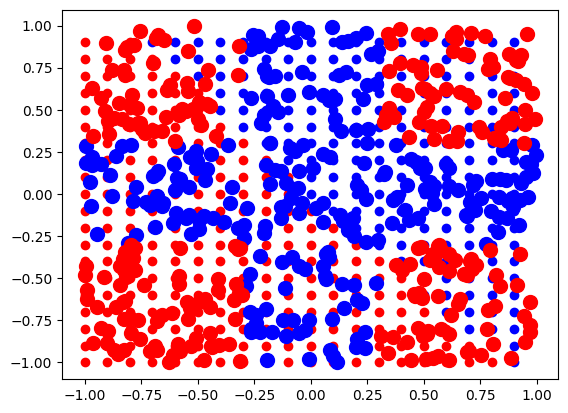

In [14]:
# Dataset inputs
X = np.random.random((500, 2)) * 2.0 - 1.0

# Dataset outputs
Y = np.array([1 if abs(p[0]) <= 0.3 or abs(p[1]) <= 0.3 else -1 for p in X])

dataset_inputs = X.tolist()
dataset_expected_outputs = Y

result = []

for sublist in dataset_inputs:
    for item in sublist:
        result.append(item)

dataset_inputs = result

dataset_inputs_size = len(dataset_inputs)
dataset_expected_outputs_size = len(dataset_expected_outputs)

dim = 2

initiate_model = [0.0] * dim
initiate_model_size = len(initiate_model)
initiate_model_type = ctypes.c_float * initiate_model_size

my_lib.create_linear_model.argtypes = [initiate_model_type, ctypes.c_int]
my_lib.create_linear_model.restype = ctypes.POINTER(ctypes.c_float)

native_initiate_model = initiate_model_type(*initiate_model)

model = my_lib.create_linear_model(native_initiate_model, initiate_model_size)

final_size = dim + 1

tab_model = []

for a in range(final_size):
    tab_model.append(model[a])

tab_model_size = len(tab_model)
tab_model_type = ctypes.c_float * tab_model_size

native_tab_model = tab_model_type(*tab_model)

for _ in range(100):
    points_x1_blue = []
    points_x2_blue = []

    points_x1_red = []
    points_x2_red = []

    for i in np.arange(-1.0, 1.0, 0.1):
        for j in np.arange(-1.0, 1.0, 0.1):

            tab_index = []

            tab_index.append(i)
            tab_index.append(j)

            tab_index_size = len(tab_index)
            tab_index_type = ctypes.c_float * tab_index_size

            my_lib.predict_linear_model_classification.argtypes = [tab_model_type, ctypes.c_int, tab_index_type,
                                                                   ctypes.c_int]

            my_lib.predict_linear_model_classification.restype = ctypes.c_float

            native_tab_index = tab_index_type(*tab_index)

            if my_lib.predict_linear_model_classification(native_tab_model, tab_model_size, native_tab_index,
                                                             dataset_inputs_size) > 0.0:
                points_x1_blue.append(i)
                points_x2_blue.append(j)

            else:
                points_x1_red.append(i)
                points_x2_red.append(j)

    plt.scatter(points_x1_blue, points_x2_blue, c='blue')
    plt.scatter(points_x1_red, points_x2_red, c='red')

    plt.scatter([X[p][0] for p in range(len(Y)) if Y[p] > 0], [X[p][1] for p in range(len(Y)) if Y[p] > 0],
                c='blue', s=100)
    plt.scatter([X[p][0] for p in range(len(Y)) if Y[p] < 0], [X[p][1] for p in range(len(Y)) if Y[p] < 0],
                c='red', s=100)

    plt.show()
    plt.clf()

    dataset_inputs_type = ctypes.c_float * dataset_inputs_size
    dataset_outputs_type = ctypes.c_float * dataset_expected_outputs_size

    my_lib.train_rosenblatt_linear_model.argtypes = [tab_model_type, ctypes.c_int, dataset_inputs_type,
                                                     ctypes.c_int, dataset_outputs_type, ctypes.c_int, ctypes.c_int,
                                                     ctypes.c_float]

    my_lib.train_rosenblatt_linear_model.restype = None

    native_dataset_inputs = dataset_inputs_type(*dataset_inputs)
    native_dataset_outputs = dataset_outputs_type(*dataset_expected_outputs)

    my_lib.train_rosenblatt_linear_model(native_tab_model, tab_model_size, native_dataset_inputs,
                                         dataset_inputs_size, native_dataset_outputs, dataset_expected_outputs_size,
                                         20, 0.001)

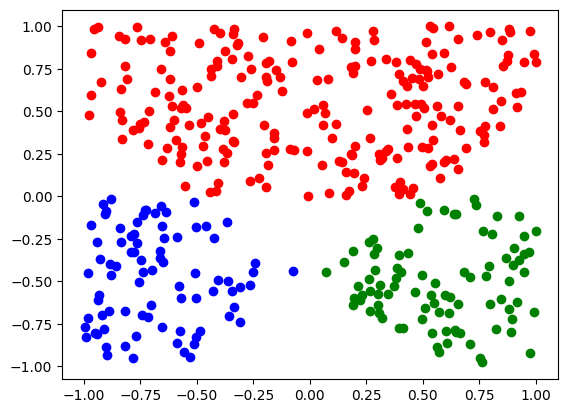

In [15]:
X = np.random.random((500, 2)) * 2.0 - 1.0
Y = np.array([[1, 0, 0] if -p[0] - p[1] - 0.5 > 0 and p[1] < 0 and p[0] - p[1] - 0.5 < 0 else 
              [0, 1, 0] if -p[0] - p[1] - 0.5 < 0 and p[1] > 0 and p[0] - p[1] - 0.5 < 0 else 
              [0, 0, 1] if -p[0] - p[1] - 0.5 < 0 and p[1] < 0 and p[0] - p[1] - 0.5 > 0 else 
              [0, 0, 0]for p in X])

X = X[[not np.all(arr == [0, 0, 0]) for arr in Y]]
Y = Y[[not np.all(arr == [0, 0, 0]) for arr in Y]]


plt.scatter(np.array(list(map(lambda elt : elt[1], filter(lambda c: Y[c[0]][0] == 1, enumerate(X)))))[:,0], np.array(list(map(lambda elt : elt[1], filter(lambda c: Y[c[0]][0] == 1, enumerate(X)))))[:,1], color='blue')
plt.scatter(np.array(list(map(lambda elt : elt[1], filter(lambda c: Y[c[0]][1] == 1, enumerate(X)))))[:,0], np.array(list(map(lambda elt : elt[1], filter(lambda c: Y[c[0]][1] == 1, enumerate(X)))))[:,1], color='red')
plt.scatter(np.array(list(map(lambda elt : elt[1], filter(lambda c: Y[c[0]][2] == 1, enumerate(X)))))[:,0], np.array(list(map(lambda elt : elt[1], filter(lambda c: Y[c[0]][2] == 1, enumerate(X)))))[:,1], color='green')
plt.show()
plt.clf()

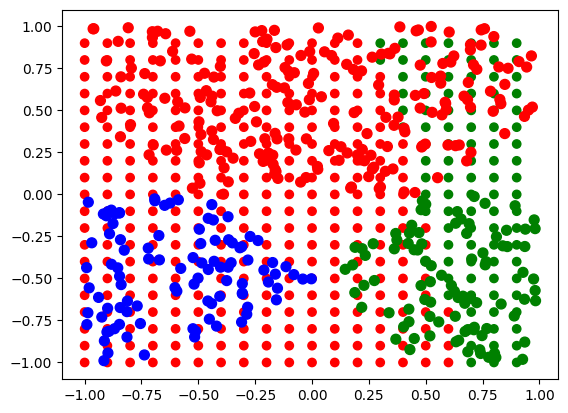

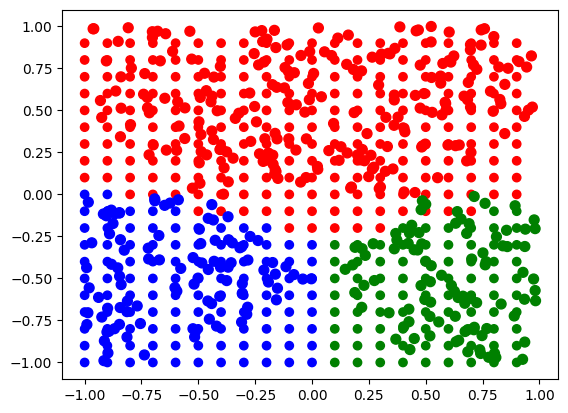

In [16]:
X = np.random.random((500, 2)) * 2.0 - 1.0
Y = np.array([[1, 0, 0] if -p[0] - p[1] - 0.5 > 0 and p[1] < 0 and p[0] - p[1] - 0.5 < 0 else
              [0, 1, 0] if -p[0] - p[1] - 0.5 < 0 and p[1] > 0 and p[0] - p[1] - 0.5 < 0 else
              [0, 0, 1] if -p[0] - p[1] - 0.5 < 0 and p[1] < 0 and p[0] - p[1] - 0.5 > 0 else
              [0, 0, 0] for p in X])

X = X[[not np.all(arr == [0, 0, 0]) for arr in Y]]  # Dataset inputs
Y = Y[[not np.all(arr == [0, 0, 0]) for arr in Y]]  # Dataset outputs

arr = [2, 3]
arr_size = len(arr)
arr_type = ctypes.c_int * arr_size

my_lib.create_mlp_model.argtypes = [arr_type, ctypes.c_int]
my_lib.create_mlp_model.restype = ctypes.c_void_p

native_arr = arr_type(*arr)

# Creation of the MLP model
model = my_lib.create_mlp_model(native_arr, arr_size)

dataset_inputs = X
dataset_expected_outputs = Y

points = [[i / 10.0, j / 10.0] for i in range(-10, 10) for j in range(-10, 10)]

predicted_values = []

for p in points:

    p_size = len(p)
    p_type = ctypes.c_float * p_size

    my_lib.predict_mlp_model_classification.argtypes = [ctypes.c_void_p, p_type, ctypes.c_int]
    my_lib.predict_mlp_model_classification.restype = ctypes.POINTER(ctypes.c_float)

    native_p = p_type(*p)

    predict = my_lib.predict_mlp_model_classification(model, native_p, p_size)

    tab_predict = []

    for q in range(3):
        tab_predict.append(predict[q])

    predicted_values.append(tab_predict)

classes = [np.argmax(v) for v in predicted_values]
colors = ['blue' if c == 0 else ('red' if c == 1 else 'green') for c in classes]

classes_dataset = [np.argmax(v) for v in dataset_expected_outputs]
colors_dataset = ['blue' if c == 0 else ('red' if c == 1 else 'green') for c in classes_dataset]

plt.scatter([p[0] for p in points], [p[1] for p in points], c=colors)
plt.scatter([p[0] for p in dataset_inputs], [p[1] for p in dataset_inputs], c=colors_dataset, s=50)
plt.show()

dataset_inputs_for_train = []
for i in dataset_inputs:
    dataset_inputs_for_train.append(i[0])
    dataset_inputs_for_train.append(i[1])

dataset_outputs = []
for j in dataset_expected_outputs:
    dataset_outputs.append(j[0])
    dataset_outputs.append(j[1])
    dataset_outputs.append(j[2])

dataset_inputs_size = len(dataset_inputs_for_train)
dataset_outputs_size = len(dataset_outputs)

dataset_inputs_type = ctypes.c_float * dataset_inputs_size
dataset_outputs_type = ctypes.c_float * dataset_outputs_size

my_lib.train_classification_stochastic_backprop_mlp_model.argtypes = [ctypes.c_void_p, dataset_inputs_type,
                                                                      ctypes.c_int,
                                                                      dataset_outputs_type, ctypes.c_int,
                                                                      ctypes.c_float,
                                                                      ctypes.c_int]

my_lib.train_classification_stochastic_backprop_mlp_model.restype = None

native_dataset_inputs = dataset_inputs_type(*dataset_inputs_for_train)
native_dataset_outputs = dataset_outputs_type(*dataset_outputs)

my_lib.train_classification_stochastic_backprop_mlp_model(model, native_dataset_inputs,
                                                          dataset_inputs_size,
                                                          native_dataset_outputs,
                                                          dataset_outputs_size, 0.001, 100000)

predicted_values = []

for p in points:

    p_size = len(p)
    p_type = ctypes.c_float * p_size

    my_lib.predict_mlp_model_classification.argtypes = [ctypes.c_void_p, p_type, ctypes.c_int]
    my_lib.predict_mlp_model_classification.restype = ctypes.POINTER(ctypes.c_float)

    native_p = p_type(*p)

    predict = my_lib.predict_mlp_model_classification(model, native_p, p_size)

    tab_predict = []

    for q in range(3):
        tab_predict.append(predict[q])

    predicted_values.append(tab_predict)

classes = [np.argmax(v) for v in predicted_values]
colors = ['blue' if c == 0 else ('red' if c == 1 else 'green') for c in classes]

plt.scatter([p[0] for p in points], [p[1] for p in points], c=colors)
plt.scatter([p[0] for p in dataset_inputs], [p[1] for p in dataset_inputs], c=colors_dataset, s=50)
plt.show()

my_lib.destroy_mlp_model.argtypes = [ctypes.c_void_p]
my_lib.destroy_mlp_model.restype = None

my_lib.destroy_mlp_model(model)  # Model erase

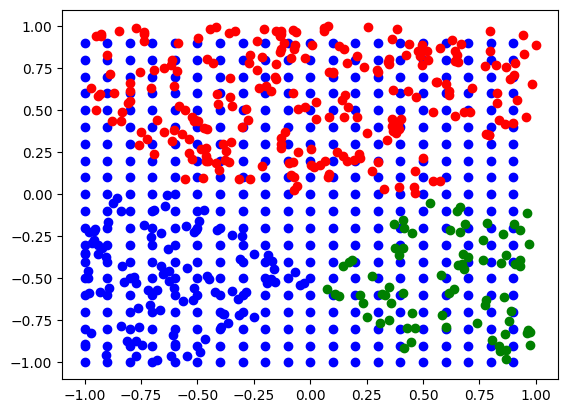

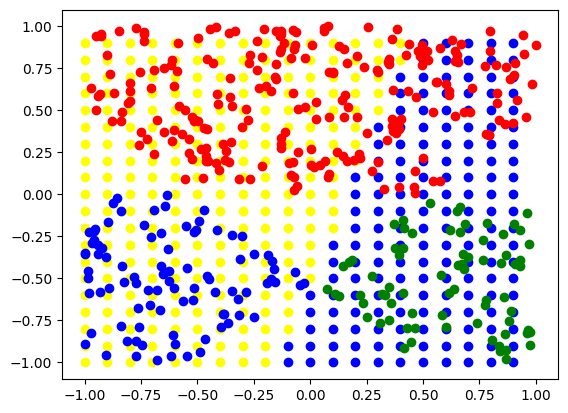

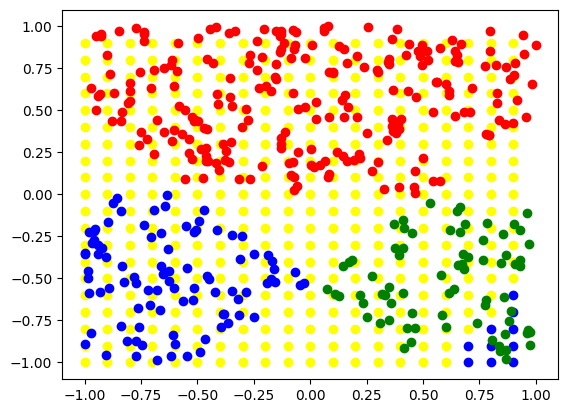

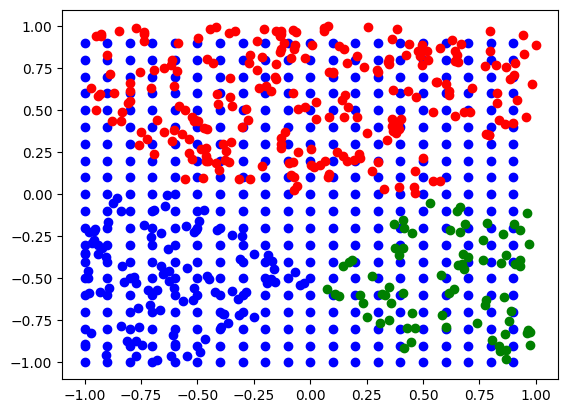

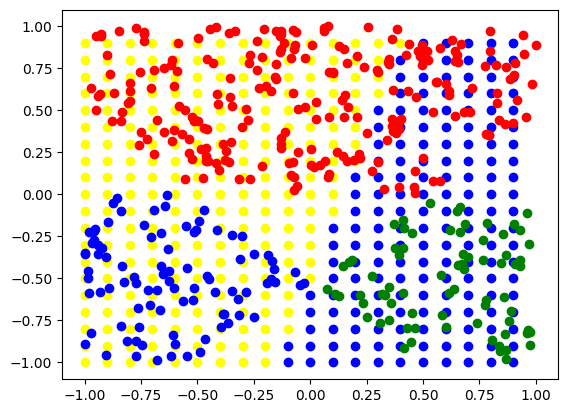

...

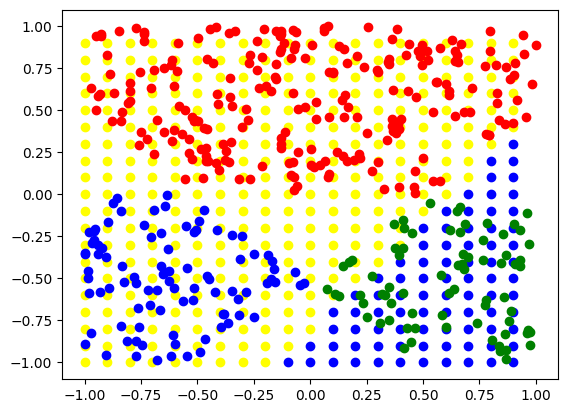

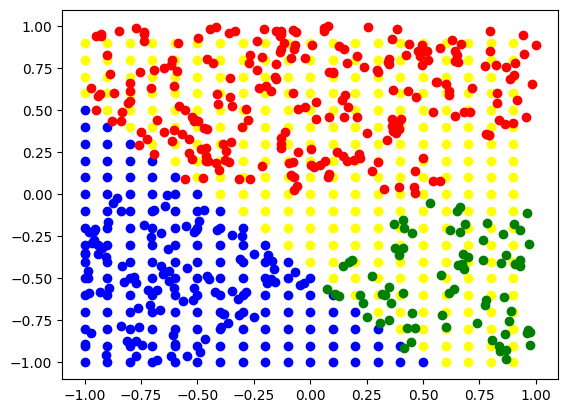

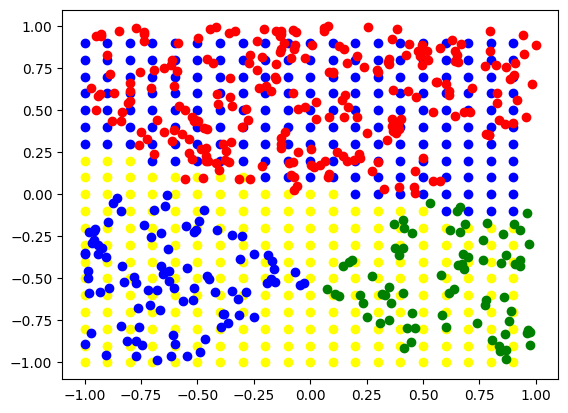

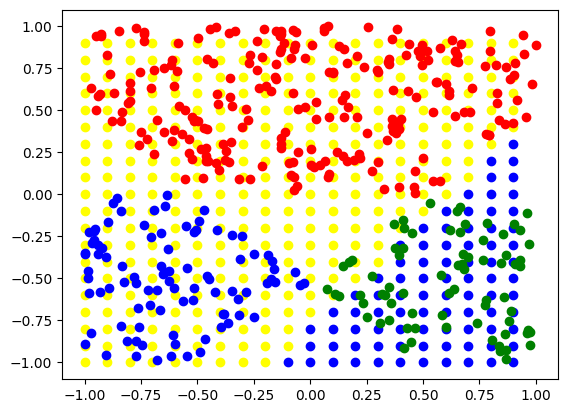

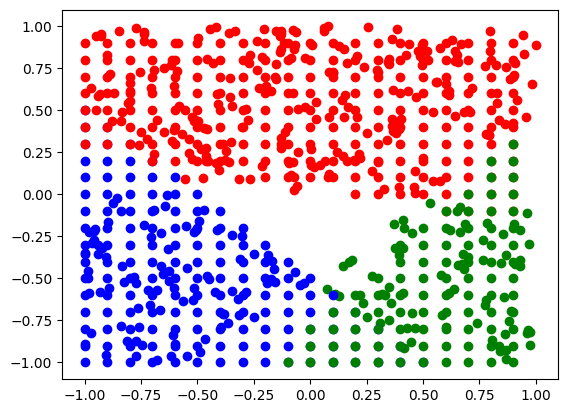

In [18]:
X = np.random.random((500, 2)) * 2.0 - 1.0
Y = np.array([[1, 0, 0] if -p[0] - p[1] - 0.5 > 0 and p[1] < 0 and p[0] - p[1] - 0.5 < 0 else
              [0, 1, 0] if -p[0] - p[1] - 0.5 < 0 and p[1] > 0 and p[0] - p[1] - 0.5 < 0 else
              [0, 0, 1] if -p[0] - p[1] - 0.5 < 0 and p[1] < 0 and p[0] - p[1] - 0.5 > 0 else
              [0, 0, 0] for p in X])

X = X[[not np.all(arr == [0, 0, 0]) for arr in Y]]
Y = Y[[not np.all(arr == [0, 0, 0]) for arr in Y]]

dataset_inputs = X.tolist()  # Dataset inputs

result = []

for sublist in dataset_inputs:
    for item in sublist:
        result.append(item)

dataset_inputs = result

temp_tmp_dataset = []
tmp_dataset_expected_outputs = []

temp_blue_dataset = []
blue_dataset_expected_outputs = []

temp_red_dataset = []
red_dataset_expected_outputs = []

temp_green_dataset = []
green_dataset_expected_outputs = []

#### Blue & tmp expected outputs
for blue_arr in Y:
    temp_blue_dataset.append(blue_arr[0])
    temp_tmp_dataset.append(blue_arr[0])

for temp_blue in temp_blue_dataset:

    if temp_blue == 1:
        blue_dataset_expected_outputs.append(1)
        tmp_dataset_expected_outputs.append(1)

    else:
        blue_dataset_expected_outputs.append(-1)
        tmp_dataset_expected_outputs.append(-1)

#### Red expected outputs
for red_arr in Y:
    temp_red_dataset.append(red_arr[1])

for temp_red in temp_red_dataset:

    if temp_red == 1:
        red_dataset_expected_outputs.append(1)

    else:
        red_dataset_expected_outputs.append(-1)

#### Green expected outputs
for green_arr in Y:
    temp_green_dataset.append(green_arr[2])

for temp_green in temp_green_dataset:

    if temp_green == 1:
        green_dataset_expected_outputs.append(1)

    else:
        green_dataset_expected_outputs.append(-1)

dim = 3

my_lib.create_linear_model.argtypes = [ctypes.c_int]
my_lib.create_linear_model.restype = ctypes.POINTER(ctypes.c_float)

temp_model = my_lib.create_linear_model(dim)
blue_model = my_lib.create_linear_model(dim)
red_model = my_lib.create_linear_model(dim)
green_model = my_lib.create_linear_model(dim)

#dim = dim + 1

temp_model_type = type(temp_model)

dataset_inputs_size = len(dataset_inputs)

for _ in range(100):

    points_x1_blue_train = []
    points_x2_blue_train = []

    points_x1_red_train = []
    points_x2_red_train = []

    points_x1_green_train = []
    points_x2_green_train = []

    points_x1_blue_test = []
    points_x2_blue_test = []

    points_x1_red_test = []
    points_x2_red_test = []

    points_x1_green_test = []
    points_x2_green_test = []

    for i in np.arange(-1.0, 1.0, 0.1):
        for j in np.arange(-1.0, 1.0, 0.1):

            tab_index = []

            tab_index.append(i)
            tab_index.append(j)

            tab_index_size = len(tab_index)
            tab_index_type = ctypes.c_float * tab_index_size

            my_lib.predict_linear_model_classification.argtypes = [temp_model_type, ctypes.c_int,
                                                                   tab_index_type,
                                                                   ctypes.c_int]

            my_lib.predict_linear_model_classification.restype = ctypes.c_float

            native_tab_index = tab_index_type(*tab_index)

            blue_predict = my_lib.predict_linear_model_classification(blue_model, dim,
                                                                      native_tab_index,
                                                                      dataset_inputs_size)

            red_predict = my_lib.predict_linear_model_classification(red_model, dim,
                                                                      native_tab_index,
                                                                      dataset_inputs_size)

            green_predict = my_lib.predict_linear_model_classification(green_model, dim,
                                                                      native_tab_index,
                                                                      dataset_inputs_size)

            if blue_predict > 0.0:
                points_x1_blue_train.append(i)
                points_x2_blue_train.append(j)

            else:
                points_x1_blue_test.append(i)
                points_x2_blue_test.append(j)

            if red_predict > 0.0:
                points_x1_red_train.append(i)
                points_x2_red_train.append(j)

            else:
                points_x1_red_test.append(i)
                points_x2_red_test.append(j)

            if green_predict > 0.0:
                points_x1_green_train.append(i)
                points_x2_green_train.append(j)

            else:
                points_x1_green_test.append(i)
                points_x2_green_test.append(j)

    plt.scatter(points_x1_blue_train, points_x2_blue_train, c='blue')
    plt.scatter(points_x1_blue_test, points_x2_blue_test, c='yellow')

    plt.scatter(np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][0] == 1, enumerate(X)))))[:, 0],
                np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][0] == 1, enumerate(X)))))[:, 1],
                color='blue')
    plt.scatter(np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][1] == 1, enumerate(X)))))[:, 0],
                np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][1] == 1, enumerate(X)))))[:, 1],
                color='red')
    plt.scatter(np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][2] == 1, enumerate(X)))))[:, 0],
                np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][2] == 1, enumerate(X)))))[:, 1],
                color='green')
    plt.show()
    plt.clf()

    plt.scatter(points_x1_red_train, points_x2_red_train, c='blue')
    plt.scatter(points_x1_red_test, points_x2_red_test, c='yellow')

    plt.scatter(np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][0] == 1, enumerate(X)))))[:, 0],
                np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][0] == 1, enumerate(X)))))[:, 1],
                color='blue')
    plt.scatter(np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][1] == 1, enumerate(X)))))[:, 0],
                np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][1] == 1, enumerate(X)))))[:, 1],
                color='red')
    plt.scatter(np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][2] == 1, enumerate(X)))))[:, 0],
                np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][2] == 1, enumerate(X)))))[:, 1],
                color='green')
    plt.show()
    plt.clf()

    plt.scatter(points_x1_green_train, points_x2_green_train, c='blue')
    plt.scatter(points_x1_green_test, points_x2_green_test, c='yellow')

    plt.scatter(np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][0] == 1, enumerate(X)))))[:, 0],
                np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][0] == 1, enumerate(X)))))[:, 1],
                color='blue')
    plt.scatter(np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][1] == 1, enumerate(X)))))[:, 0],
                np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][1] == 1, enumerate(X)))))[:, 1],
                color='red')
    plt.scatter(np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][2] == 1, enumerate(X)))))[:, 0],
                np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][2] == 1, enumerate(X)))))[:, 1],
                color='green')
    plt.show()
    plt.clf()

    dataset_inputs_size = len(dataset_inputs)
    dataset_outputs_size = len(tmp_dataset_expected_outputs)

    dataset_inputs_type = ctypes.c_float * dataset_inputs_size
    dataset_outputs_type = ctypes.c_float * dataset_outputs_size

    my_lib.train_rosenblatt_linear_model.argtypes = [temp_model_type, ctypes.c_int, dataset_inputs_type,
                                                     ctypes.c_int, dataset_outputs_type, ctypes.c_int, ctypes.c_int,
                                                     ctypes.c_float]

    my_lib.train_rosenblatt_linear_model.restype = None

    blue_dataset_outputs_size = len(blue_dataset_expected_outputs)
    red_dataset_outputs_size = len(red_dataset_expected_outputs)
    green_dataset_outputs_size = len(green_dataset_expected_outputs)

    blue_dataset_outputs_type = ctypes.c_float * blue_dataset_outputs_size
    red_dataset_outputs_type = ctypes.c_float * red_dataset_outputs_size
    green_dataset_outputs_type = ctypes.c_float * green_dataset_outputs_size

    native_dataset_inputs = dataset_inputs_type(*dataset_inputs)

    native_blue_dataset_outputs = blue_dataset_outputs_type(*blue_dataset_expected_outputs)
    native_red_dataset_outputs = red_dataset_outputs_type(*red_dataset_expected_outputs)
    native_green_dataset_outputs = green_dataset_outputs_type(*green_dataset_expected_outputs)

    my_lib.train_rosenblatt_linear_model(blue_model, dim, native_dataset_inputs,
                                         dataset_inputs_size, native_blue_dataset_outputs,
                                         blue_dataset_outputs_size,
                                         20, 0.001)

    my_lib.train_rosenblatt_linear_model(red_model, dim, native_dataset_inputs,
                                         dataset_inputs_size, native_red_dataset_outputs,
                                         red_dataset_outputs_size,
                                         20, 0.001)

    my_lib.train_rosenblatt_linear_model(green_model, dim, native_dataset_inputs,
                                         dataset_inputs_size, native_green_dataset_outputs,
                                         green_dataset_outputs_size,
                                         20, 0.001)

plt.scatter(np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][0] == 1, enumerate(X)))))[:, 0],
            np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][0] == 1, enumerate(X)))))[:, 1],
            color='blue')
plt.scatter(np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][1] == 1, enumerate(X)))))[:, 0],
            np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][1] == 1, enumerate(X)))))[:, 1],
            color='red')
plt.scatter(np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][2] == 1, enumerate(X)))))[:, 0],
            np.array(list(map(lambda elt: elt[1], filter(lambda c: Y[c[0]][2] == 1, enumerate(X)))))[:, 1],
            color='green')

plt.scatter(points_x1_blue_train, points_x2_blue_train, c='blue')
plt.scatter(points_x1_red_train, points_x2_red_train, c='red')
plt.scatter(points_x1_green_train, points_x2_green_train, c='green')

plt.show()
plt.clf()

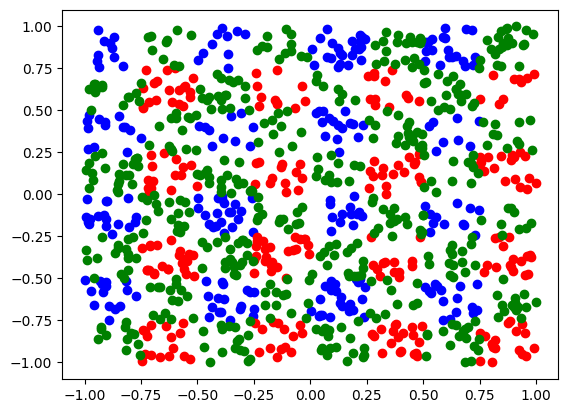

In [19]:
X = np.random.random((1000, 2)) * 2.0 - 1.0
Y = np.array([[1, 0, 0] if abs(p[0] % 0.5) <= 0.25 and abs(p[1] % 0.5) > 0.25 else [0, 1, 0] if abs(p[0] % 0.5) > 0.25 and abs(p[1] % 0.5) <= 0.25 else [0, 0, 1] for p in X])

plt.scatter(np.array(list(map(lambda elt : elt[1], filter(lambda c: Y[c[0]][0] == 1, enumerate(X)))))[:,0], np.array(list(map(lambda elt : elt[1], filter(lambda c: Y[c[0]][0] == 1, enumerate(X)))))[:,1], color='blue')
plt.scatter(np.array(list(map(lambda elt : elt[1], filter(lambda c: Y[c[0]][1] == 1, enumerate(X)))))[:,0], np.array(list(map(lambda elt : elt[1], filter(lambda c: Y[c[0]][1] == 1, enumerate(X)))))[:,1], color='red')
plt.scatter(np.array(list(map(lambda elt : elt[1], filter(lambda c: Y[c[0]][2] == 1, enumerate(X)))))[:,0], np.array(list(map(lambda elt : elt[1], filter(lambda c: Y[c[0]][2] == 1, enumerate(X)))))[:,1], color='green')
plt.show()
plt.clf()

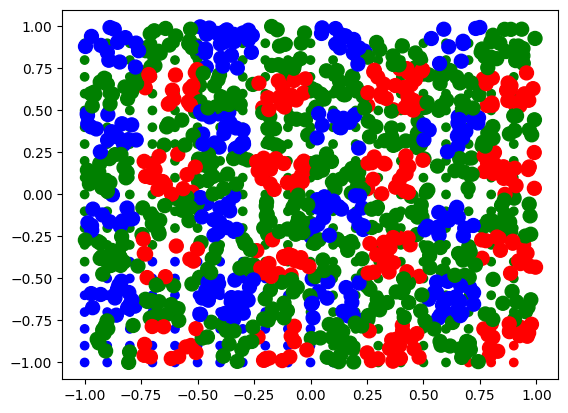

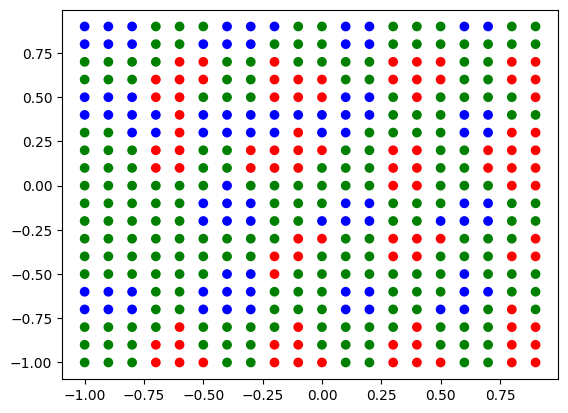

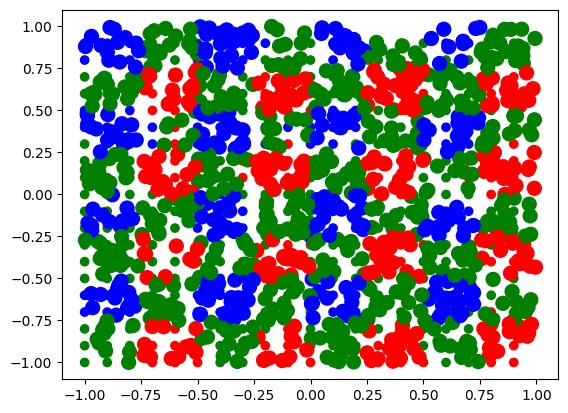

In [21]:
X = np.random.random((1000, 2)) * 2.0 - 1.0
Y = np.array([[1, 0, 0] if abs(p[0] % 0.5) <= 0.25 and abs(p[1] % 0.5) > 0.25 else [0, 1, 0] if abs(
    p[0] % 0.5) > 0.25 and abs(p[1] % 0.5) <= 0.25 else [0, 0, 1] for p in X])

arr = [2, 20, 20, 3]
arr_size = len(arr)
arr_type = ctypes.c_int * arr_size

my_lib.create_mlp_model.argtypes = [arr_type, ctypes.c_int]
my_lib.create_mlp_model.restype = ctypes.c_void_p

native_arr = arr_type(*arr)

# Creation of the MLP model
model = my_lib.create_mlp_model(native_arr, arr_size)

dataset_inputs = X  # Dataset inputs
dataset_expected_outputs = Y  # Dataset outputs

points = [[i / 10, j / 10] for i in range(-10, 10) for j in range(-10, 10)]

predicted_values = []

for p in points:

    p_size = len(p)
    p_type = ctypes.c_float * p_size

    my_lib.predict_mlp_model_classification.argtypes = [ctypes.c_void_p, p_type, ctypes.c_int]
    my_lib.predict_mlp_model_classification.restype = ctypes.POINTER(ctypes.c_float)

    native_p = p_type(*p)

    predict = my_lib.predict_mlp_model_classification(model, native_p, p_size)

    tab_predict = []

    for q in range(3):
        tab_predict.append(predict[q])

    predicted_values.append(tab_predict)

classes = [np.argmax(v) for v in predicted_values]
colors = ['blue' if c == 0 else ('red' if c == 1 else 'green') for c in classes]

classes_dataset = [np.argmax(v) for v in dataset_expected_outputs]
colors_dataset = ['blue' if c == 0 else ('red' if c == 1 else 'green') for c in classes_dataset]

plt.scatter([p[0] for p in points], [p[1] for p in points], c=colors)
plt.scatter([p[0] for p in dataset_inputs], [p[1] for p in dataset_inputs], c=colors_dataset, s=100)
plt.show()

dataset_inputs_for_train = []

for i in dataset_inputs:
    dataset_inputs_for_train.append(i[0])
    dataset_inputs_for_train.append(i[1])

dataset_outputs = []

for j in dataset_expected_outputs:
    dataset_outputs.append(j[0])
    dataset_outputs.append(j[1])
    dataset_outputs.append(j[2])

dataset_input_size = len(dataset_inputs_for_train)
dataset_output_size = len(dataset_outputs)

dataset_input_type = ctypes.c_float * dataset_input_size
dataset_output_type = ctypes.c_float * dataset_output_size

my_lib.train_classification_stochastic_backprop_mlp_model.argtypes = [ctypes.c_void_p, dataset_input_type,
                                                                      ctypes.c_int,
                                                                      dataset_output_type,
                                                                      ctypes.c_int, ctypes.c_float, ctypes.c_int]

my_lib.train_classification_stochastic_backprop_mlp_model.restype = None

native_dataset_input = dataset_input_type(*dataset_inputs_for_train)
native_dataset_output = dataset_output_type(*dataset_outputs)

my_lib.train_classification_stochastic_backprop_mlp_model(model, native_dataset_input, dataset_input_size,
                                                          native_dataset_output, dataset_output_size, 0.01, 1000000)

predicted_values = []

for p in points:

    p_size = len(p)
    p_type = ctypes.c_float * p_size

    my_lib.predict_mlp_model_classification.argtypes = [ctypes.c_void_p, p_type, ctypes.c_int]
    my_lib.predict_mlp_model_classification.restype = ctypes.POINTER(ctypes.c_float)

    native_p = p_type(*p)

    predict = my_lib.predict_mlp_model_classification(model, native_p, p_size)

    tab_predict = []

    for q in range(3):
        tab_predict.append(predict[q])

    predicted_values.append(tab_predict)

classes = [np.argmax(v) for v in predicted_values]
colors = ['blue' if c == 0 else ('red' if c == 1 else 'green') for c in classes]

classes_dataset = [np.argmax(v) for v in dataset_expected_outputs]
colors_dataset = ['blue' if c == 0 else ('red' if c == 1 else 'green') for c in classes_dataset]

plt.scatter([p[0] for p in points], [p[1] for p in points], c=colors)
plt.show()
plt.clf()

plt.scatter([p[0] for p in points], [p[1] for p in points], c=colors)
plt.scatter([p[0] for p in dataset_inputs], [p[1] for p in dataset_inputs], c=colors_dataset, s=100)
plt.show()

my_lib.destroy_mlp_model.argtypes = [ctypes.c_void_p]
my_lib.destroy_mlp_model.restype = None
my_lib.destroy_mlp_model(model)  # Model erase

In [ ]:
# Code modèle linéraire Multi Cross

# II) Seconde Catégorie : Régression

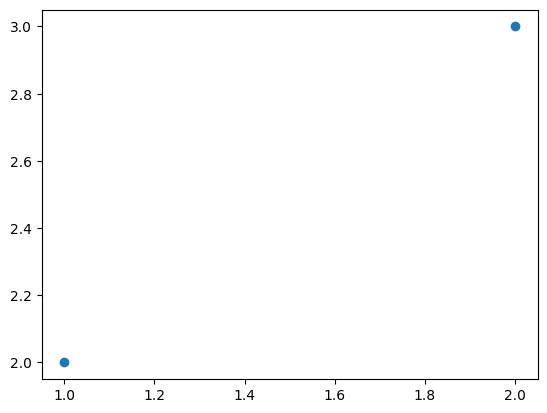

In [22]:
X = np.array([
      [1],
      [2]
])
Y = np.array([
      2,
      3
])


plt.scatter(X,Y)
plt.show()
plt.clf()

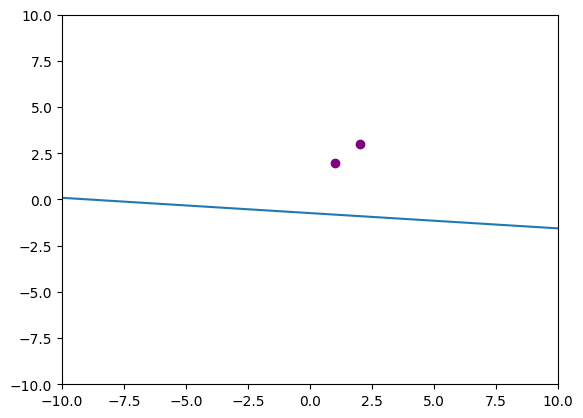

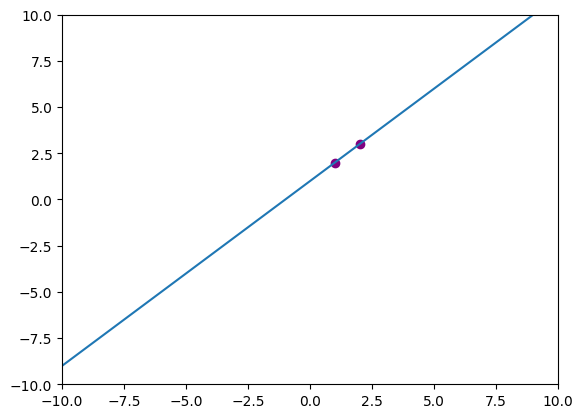

In [23]:
X = np.array([[1], [2]])
Y = np.array([2, 3])

arr = [1, 1]
arr_size = len(arr)
arr_type = ctypes.c_int * arr_size

my_lib.create_mlp_model.argtypes = [arr_type, ctypes.c_int]
my_lib.create_mlp_model.restype = ctypes.c_void_p

np_arr = np.array(arr)
native_arr = np.ctypeslib.as_ctypes(np_arr)

model = my_lib.create_mlp_model(native_arr, arr_size)

dataset_inputs = X.tolist()

result = []

for sublist in dataset_inputs:
    for item in sublist:
        result.append(item)

dataset_inputs = result  # Dataset inputs
dataset_expected_outputs = Y.tolist()  # Dataset outputs

points_x = []
points_y = []

plt.axis([-10, 10, -10, 10])

for i in range(-10, 11):
    points_x.append(i)

    arr_i = [i]
    arr_i_size = len(arr_i)
    arr_i_type = ctypes.c_float * arr_i_size

    my_lib.predict_mlp_model_regression.argtypes = [ctypes.c_void_p, arr_i_type, ctypes.c_int]
    my_lib.predict_mlp_model_regression.restype = ctypes.POINTER(ctypes.c_float)

    native_arr_i = arr_i_type(*arr_i)

    predict = my_lib.predict_mlp_model_regression(model, native_arr_i, arr_i_size)
    points_y.append(predict[0])

plt.plot(points_x, points_y)
plt.scatter(dataset_inputs, dataset_expected_outputs, c="purple")
plt.show()

arr_dataset_inputs_size = len(dataset_inputs)
arr_dataset_outputs_size = len(dataset_expected_outputs)

arr_dataset_inputs_type = ctypes.c_float * arr_dataset_inputs_size
arr_dataset_outputs_type = ctypes.c_float * arr_dataset_outputs_size

my_lib.train_regression_stochastic_backprop_mlp_model.argtypes = [ctypes.c_void_p, arr_dataset_inputs_type, ctypes.c_int, arr_dataset_outputs_type, ctypes.c_int, ctypes.c_float, ctypes.c_int]

my_lib.train_regression_stochastic_backprop_mlp_model.restype = None

native_arr_dataset_inputs = arr_dataset_inputs_type(*dataset_inputs)
native_arr_dataset_outputs = arr_dataset_outputs_type(*dataset_expected_outputs)

my_lib.train_regression_stochastic_backprop_mlp_model(model, native_arr_dataset_inputs, arr_dataset_inputs_size, native_arr_dataset_outputs, arr_dataset_outputs_size, 0.01, 100000)

points_x = []
points_y = []

plt.axis([-10, 10, -10, 10])

for i in range(-10, 11):
    points_x.append(i)

    arr_i = [i]
    arr_i_size = len(arr_i)
    arr_i_type = ctypes.c_float * arr_i_size

    my_lib.predict_mlp_model_regression.argtypes = [ctypes.c_void_p, arr_i_type, ctypes.c_int]
    my_lib.predict_mlp_model_regression.restype = ctypes.POINTER(ctypes.c_float)

    native_arr_i = arr_i_type(*arr_i)

    predict_v = my_lib.predict_mlp_model_regression(model, native_arr_i, arr_i_size)
    points_y.append(predict_v[0])

plt.plot(points_x, points_y)
plt.scatter(dataset_inputs, dataset_expected_outputs, c="purple")
plt.show()

my_lib.destroy_mlp_model.argtypes = [ctypes.c_void_p]
my_lib.destroy_mlp_model.restype = None
my_lib.destroy_mlp_model(model)  # Model erase

In [24]:
# Code modèle linéaire Linear Simple 2D

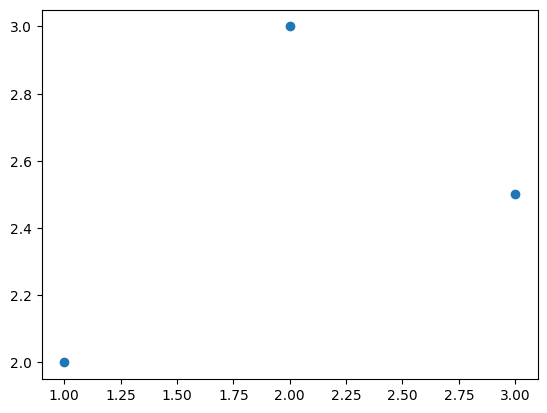

In [26]:
X = np.array([
      [1],
      [2],
      [3]
])
Y = np.array([
      2,
      3,
      2.5
])

plt.scatter(X,Y)
plt.show()
plt.clf()

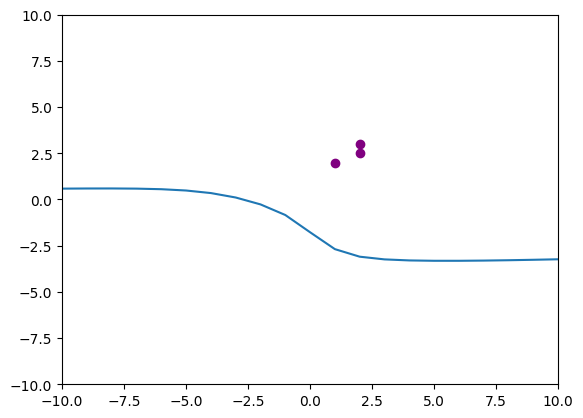

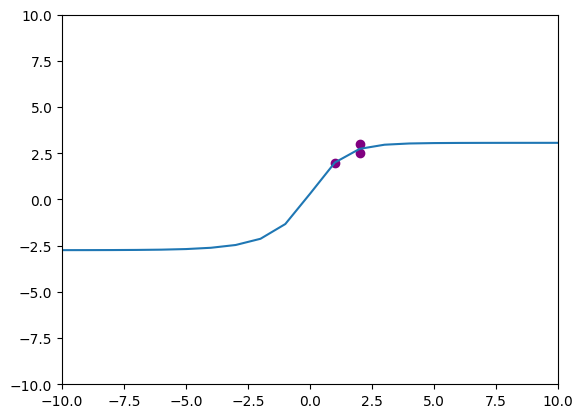

In [27]:
X = np.array([[1], [2], [2]])
Y = np.array([2, 3, 2.5])

arr = [1, 5, 1]
arr_size = len(arr)
arr_type = ctypes.c_int * arr_size

my_lib.create_mlp_model.argtypes = [arr_type, ctypes.c_int]
my_lib.create_mlp_model.restype = ctypes.c_void_p

np_arr = np.array(arr)
native_arr = np.ctypeslib.as_ctypes(np_arr)

model = my_lib.create_mlp_model(native_arr, arr_size)

dataset_inputs = X.tolist()

result = []

for sublist in dataset_inputs:
    for item in sublist:
        result.append(item)

dataset_inputs = result  # Dataset inputs
dataset_expected_outputs = Y.tolist()  # Dataset outputs

points_x = []
points_y = []

plt.axis([-10, 10, -10, 10])

for i in range(-10, 11):
    points_x.append(i)

    arr_i = [i]
    arr_i_size = len(arr_i)
    arr_i_type = ctypes.c_float * arr_i_size

    my_lib.predict_mlp_model_regression.argtypes = [ctypes.c_void_p, arr_i_type, ctypes.c_int]
    my_lib.predict_mlp_model_regression.restype = ctypes.POINTER(ctypes.c_float)

    native_arr_i = arr_i_type(*arr_i)

    predict = my_lib.predict_mlp_model_regression(model, native_arr_i, arr_i_size)
    points_y.append(predict[0])

plt.plot(points_x, points_y)
plt.scatter(dataset_inputs, dataset_expected_outputs, c="purple")
plt.show()

arr_dataset_inputs_size = len(dataset_inputs)
arr_dataset_outputs_size = len(dataset_expected_outputs)

arr_dataset_inputs_type = ctypes.c_float * arr_dataset_inputs_size
arr_dataset_outputs_type = ctypes.c_float * arr_dataset_outputs_size

my_lib.train_regression_stochastic_backprop_mlp_model.argtypes = [ctypes.c_void_p, arr_dataset_inputs_type, ctypes.c_int, arr_dataset_outputs_type, ctypes.c_int, ctypes.c_float, ctypes.c_int]

my_lib.train_regression_stochastic_backprop_mlp_model.restype = None

native_arr_dataset_inputs = arr_dataset_inputs_type(*dataset_inputs)
native_arr_dataset_outputs = arr_dataset_outputs_type(*dataset_expected_outputs)

my_lib.train_regression_stochastic_backprop_mlp_model(model, native_arr_dataset_inputs, arr_dataset_inputs_size, native_arr_dataset_outputs, arr_dataset_outputs_size, 0.01, 100000)

points_x = []
points_y = []

plt.axis([-10, 10, -10, 10])

for i in range(-10, 11):
    points_x.append(i)

    arr_i = [i]
    arr_i_size = len(arr_i)
    arr_i_type = ctypes.c_float * arr_i_size

    my_lib.predict_mlp_model_regression.argtypes = [ctypes.c_void_p, arr_i_type, ctypes.c_int]
    my_lib.predict_mlp_model_regression.restype = ctypes.POINTER(ctypes.c_float)

    native_arr_i = arr_i_type(*arr_i)

    predict_v = my_lib.predict_mlp_model_regression(model, native_arr_i, arr_i_size)
    points_y.append(predict_v[0])

plt.plot(points_x, points_y)
plt.scatter(dataset_inputs, dataset_expected_outputs, c="purple")
plt.show()

my_lib.destroy_mlp_model.argtypes = [ctypes.c_void_p]
my_lib.destroy_mlp_model.restype = None
my_lib.destroy_mlp_model(model)  # Model erase

In [28]:
# Code modèle linéaire Non Linear Simple 2D

<Figure size 640x480 with 0 Axes>

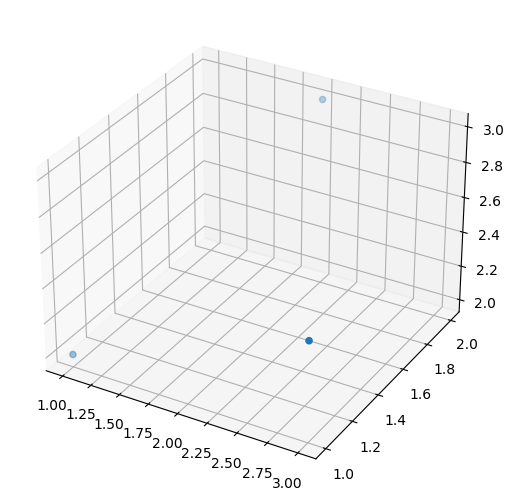

In [30]:
X = np.array([
      [1, 1],
      [2, 2],
      [3, 1]
])
Y = np.array([
      2,
      3,
      2.5
])

from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = Axes3D(fig, auto_add_to_figure=False)
ax.scatter(X[:,0],X[:,1],Y)
fig.add_axes(ax)
plt.show()
plt.clf()

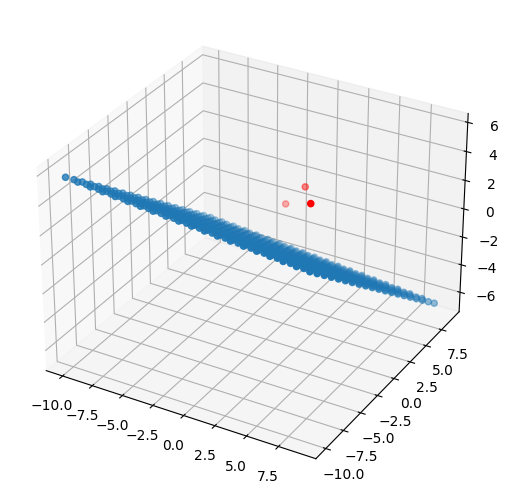

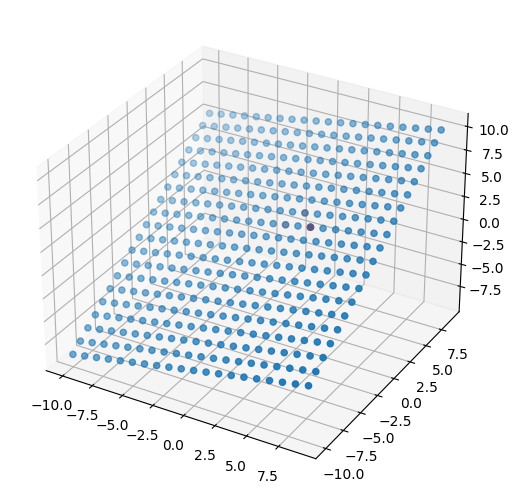

In [37]:
X = np.array([[1, 1], [2, 2], [3, 1]])
Y = np.array([2, 3, 2.5])

arr = [2, 1]
arr_size = len(arr)
arr_type = ctypes.c_int * arr_size

my_lib.create_mlp_model.argtypes = [arr_type, ctypes.c_int]
my_lib.create_mlp_model.restype = ctypes.c_void_p

np_arr = np.array(arr)
native_arr = np.ctypeslib.as_ctypes(np_arr)

model = my_lib.create_mlp_model(native_arr, arr_size)

dataset_inputs = X.tolist()

result = []

for sublist in dataset_inputs:
    for item in sublist:
        result.append(item)

dataset_inputs = result  # Dataset inputs
dataset_expected_outputs = Y.tolist()  # Dataset outputs

points = [[i, j] for i in range(-10, 10) for j in range(-10, 10)]
array_points = np.array(points)

predicted_values = []

for p in points:

    arr_p = p
    arr_p_size = len(arr_p)
    arr_p_type = ctypes.c_float * arr_p_size

    my_lib.predict_mlp_model_regression.argtypes = [ctypes.c_void_p, arr_p_type, ctypes.c_int]
    my_lib.predict_mlp_model_regression.restype = ctypes.POINTER(ctypes.c_float)

    native_arr_p = arr_p_type(*arr_p)

    predict = my_lib.predict_mlp_model_regression(model, native_arr_p, arr_p_size)
    predicted_values.append(predict[0])

fig = plt.figure()
ax = Axes3D(fig, auto_add_to_figure=False)
fig.add_axes(ax)
ax.scatter(array_points[:, 0], array_points[:, 1], predicted_values)
ax.scatter(X[:, 0], X[:, 1], Y, c='red')

plt.show()

arr_dataset_inputs_size = len(dataset_inputs)
arr_dataset_outputs_size = len(dataset_expected_outputs)

arr_dataset_inputs_type = ctypes.c_float * arr_dataset_inputs_size
arr_dataset_outputs_type = ctypes.c_float * arr_dataset_outputs_size

my_lib.train_regression_stochastic_backprop_mlp_model.argtypes = [ctypes.c_void_p, arr_dataset_inputs_type, ctypes.c_int, arr_dataset_outputs_type, ctypes.c_int, ctypes.c_float, ctypes.c_int]

my_lib.train_regression_stochastic_backprop_mlp_model.restype = None

native_arr_dataset_inputs = arr_dataset_inputs_type(*dataset_inputs)
native_arr_dataset_outputs = arr_dataset_outputs_type(*dataset_expected_outputs)

my_lib.train_regression_stochastic_backprop_mlp_model(model, native_arr_dataset_inputs, arr_dataset_inputs_size, native_arr_dataset_outputs, arr_dataset_outputs_size, 0.01, 100000)

predicted_values = []

for p in points:
    arr_p = p
    arr_p_size = len(arr_p)
    arr_p_type = ctypes.c_float * arr_p_size

    my_lib.predict_mlp_model_regression.argtypes = [ctypes.c_void_p, arr_p_type, ctypes.c_int]
    my_lib.predict_mlp_model_regression.restype = ctypes.POINTER(ctypes.c_float)

    native_arr_p = arr_p_type(*arr_p)

    predict = my_lib.predict_mlp_model_regression(model, native_arr_p, arr_p_size)
    predicted_values.append(predict[0])

fig = plt.figure()
ax = Axes3D(fig, auto_add_to_figure=False)
fig.add_axes(ax)
ax.scatter(array_points[:, 0], array_points[:, 1], predicted_values)
ax.scatter(X[:, 0], X[:, 1], Y, c='red')

plt.show()

my_lib.destroy_mlp_model.argtypes = [ctypes.c_void_p]
my_lib.destroy_mlp_model.restype = None
my_lib.destroy_mlp_model(model)  # Model erase

In [38]:
# Code modèle linéaire Linear Simple 3D

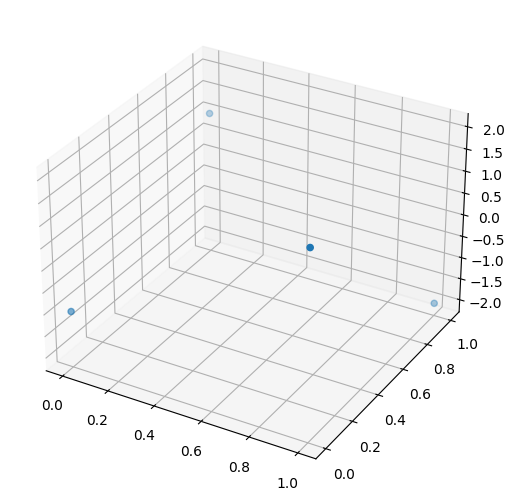

In [39]:
X = np.array([
      [1, 0],
      [0, 1],
      [1, 1],
      [0, 0],
])
Y = np.array([
      2,
      1,
      -2,
      -1
])

fig = plt.figure()
ax = Axes3D(fig, auto_add_to_figure=False)
fig.add_axes(ax)
ax.scatter(X[:,0],X[:,1],Y)
plt.show()
plt.clf()

<Figure size 640x480 with 0 Axes>

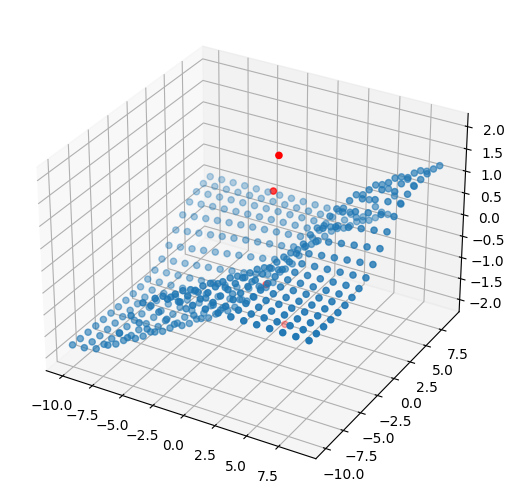

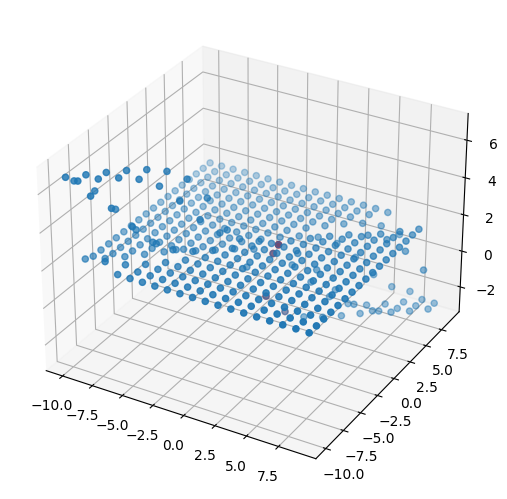

In [40]:
X = np.array([[1, 0], [0, 1], [1, 1], [0, 0]])
Y = np.array([2, 1, -2, -1])

arr = [2, 2, 1]
arr_size = len(arr)
arr_type = ctypes.c_int * arr_size

my_lib.create_mlp_model.argtypes = [arr_type, ctypes.c_int]
my_lib.create_mlp_model.restype = ctypes.c_void_p

np_arr = np.array(arr)
native_arr = np.ctypeslib.as_ctypes(np_arr)

model = my_lib.create_mlp_model(native_arr, arr_size)

dataset_inputs = X.tolist()

result = []

for sublist in dataset_inputs:
    for item in sublist:
        result.append(item)

dataset_inputs = result  # Dataset inputs
dataset_expected_outputs = Y.tolist()  # Dataset outputs

points = [[i, j] for i in range(-10, 10) for j in range(-10, 10)]
array_points = np.array(points)

predicted_values = []

for p in points:

    arr_p = p
    arr_p_size = len(arr_p)
    arr_p_type = ctypes.c_float * arr_p_size

    my_lib.predict_mlp_model_regression.argtypes = [ctypes.c_void_p, arr_p_type, ctypes.c_int]
    my_lib.predict_mlp_model_regression.restype = ctypes.POINTER(ctypes.c_float)

    native_arr_p = arr_p_type(*arr_p)

    predict = my_lib.predict_mlp_model_regression(model, native_arr_p, arr_p_size)
    predicted_values.append(predict[0])

fig = plt.figure()
ax = Axes3D(fig, auto_add_to_figure=False)
fig.add_axes(ax)
ax.scatter(array_points[:, 0], array_points[:, 1], predicted_values)
ax.scatter(X[:, 0], X[:, 1], Y, c='red')

plt.show()

arr_dataset_inputs_size = len(dataset_inputs)
arr_dataset_outputs_size = len(dataset_expected_outputs)

arr_dataset_inputs_type = ctypes.c_float * arr_dataset_inputs_size
arr_dataset_outputs_type = ctypes.c_float * arr_dataset_outputs_size

my_lib.train_regression_stochastic_backprop_mlp_model.argtypes = [ctypes.c_void_p, arr_dataset_inputs_type, ctypes.c_int, arr_dataset_outputs_type, ctypes.c_int, ctypes.c_float, ctypes.c_int]

my_lib.train_regression_stochastic_backprop_mlp_model.restype = None

native_arr_dataset_inputs = arr_dataset_inputs_type(*dataset_inputs)
native_arr_dataset_outputs = arr_dataset_outputs_type(*dataset_expected_outputs)

my_lib.train_regression_stochastic_backprop_mlp_model(model, native_arr_dataset_inputs, arr_dataset_inputs_size, native_arr_dataset_outputs, arr_dataset_outputs_size, 0.01, 100000)

predicted_values = []

for p in points:
    arr_p = p
    arr_p_size = len(arr_p)
    arr_p_type = ctypes.c_float * arr_p_size

    my_lib.predict_mlp_model_regression.argtypes = [ctypes.c_void_p, arr_p_type, ctypes.c_int]
    my_lib.predict_mlp_model_regression.restype = ctypes.POINTER(ctypes.c_float)

    native_arr_p = arr_p_type(*arr_p)

    predict = my_lib.predict_mlp_model_regression(model, native_arr_p, arr_p_size)
    predicted_values.append(predict[0])

fig = plt.figure()
ax = Axes3D(fig, auto_add_to_figure=False)
fig.add_axes(ax)
ax.scatter(array_points[:, 0], array_points[:, 1], predicted_values)
ax.scatter(X[:, 0], X[:, 1], Y, c='red')

plt.show()

my_lib.destroy_mlp_model.argtypes = [ctypes.c_void_p]
my_lib.destroy_mlp_model.restype = None
my_lib.destroy_mlp_model(model)  # Model erase

In [41]:
# Code modèle linéaire Non Linear Simple 3D

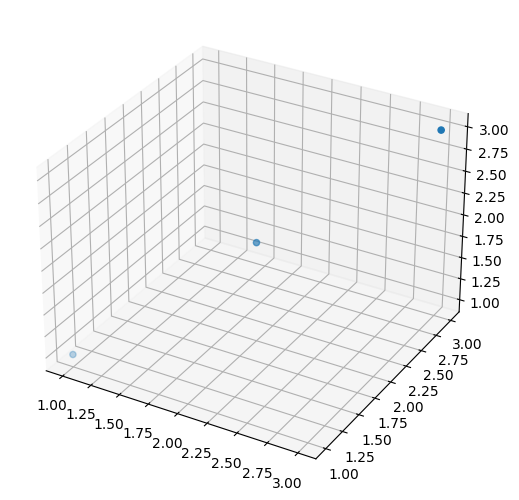

In [42]:
X = np.array([
      [1, 1],
      [2, 2],
      [3, 3]
])
Y = np.array([
      1,
      2,
      3
])

fig = plt.figure()
ax = Axes3D(fig, auto_add_to_figure=False)
fig.add_axes(ax)
ax.scatter(X[:,0],X[:,1],Y)
plt.show()
plt.clf()

<Figure size 640x480 with 0 Axes>

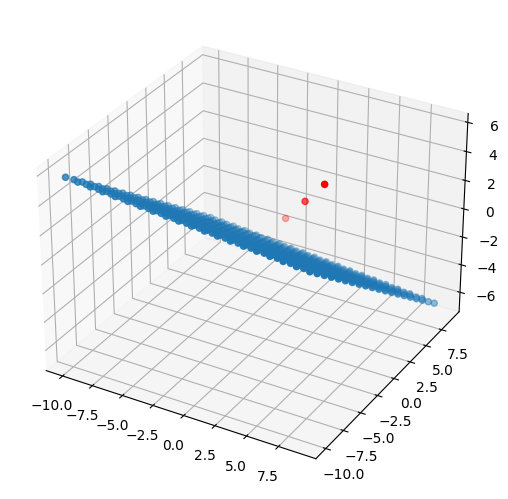

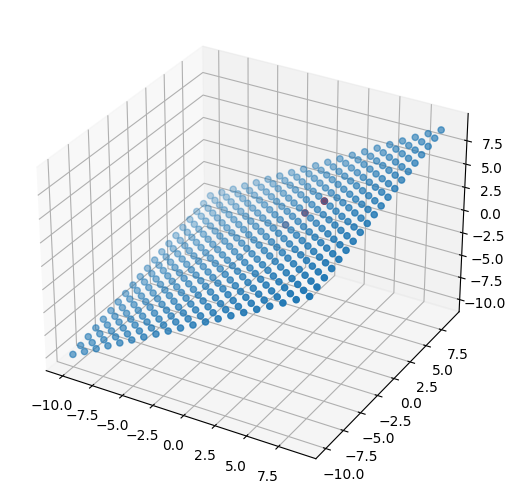

In [43]:
X = np.array([[1, 1], [2, 2], [3, 3]])
Y = np.array([1, 2, 3])

arr = [2, 1]
arr_size = len(arr)
arr_type = ctypes.c_int * arr_size

my_lib.create_mlp_model.argtypes = [arr_type, ctypes.c_int]
my_lib.create_mlp_model.restype = ctypes.c_void_p

np_arr = np.array(arr)
native_arr = np.ctypeslib.as_ctypes(np_arr)

model = my_lib.create_mlp_model(native_arr, arr_size)

dataset_inputs = X.tolist()

result = []

for sublist in dataset_inputs:
    for item in sublist:
        result.append(item)

dataset_inputs = result  # Dataset inputs
dataset_expected_outputs = Y.tolist()  # Dataset outputs

points = [[i, j] for i in range(-10, 10) for j in range(-10, 10)]
array_points = np.array(points)

predicted_values = []

for p in points:

    arr_p = p
    arr_p_size = len(arr_p)
    arr_p_type = ctypes.c_float * arr_p_size

    my_lib.predict_mlp_model_regression.argtypes = [ctypes.c_void_p, arr_p_type, ctypes.c_int]
    my_lib.predict_mlp_model_regression.restype = ctypes.POINTER(ctypes.c_float)

    native_arr_p = arr_p_type(*arr_p)

    predict = my_lib.predict_mlp_model_regression(model, native_arr_p, arr_p_size)
    predicted_values.append(predict[0])

fig = plt.figure()
ax = Axes3D(fig, auto_add_to_figure=False)
fig.add_axes(ax)
ax.scatter(array_points[:, 0], array_points[:, 1], predicted_values)
ax.scatter(X[:, 0], X[:, 1], Y, c='red')

plt.show()

arr_dataset_inputs_size = len(dataset_inputs)
arr_dataset_outputs_size = len(dataset_expected_outputs)

arr_dataset_inputs_type = ctypes.c_float * arr_dataset_inputs_size
arr_dataset_outputs_type = ctypes.c_float * arr_dataset_outputs_size

my_lib.train_regression_stochastic_backprop_mlp_model.argtypes = [ctypes.c_void_p, arr_dataset_inputs_type, ctypes.c_int, arr_dataset_outputs_type, ctypes.c_int, ctypes.c_float, ctypes.c_int]

my_lib.train_regression_stochastic_backprop_mlp_model.restype = None

native_arr_dataset_inputs = arr_dataset_inputs_type(*dataset_inputs)
native_arr_dataset_outputs = arr_dataset_outputs_type(*dataset_expected_outputs)

my_lib.train_regression_stochastic_backprop_mlp_model(model, native_arr_dataset_inputs, arr_dataset_inputs_size, native_arr_dataset_outputs, arr_dataset_outputs_size, 0.01, 100000)

predicted_values = []

for p in points:
    arr_p = p
    arr_p_size = len(arr_p)
    arr_p_type = ctypes.c_float * arr_p_size

    my_lib.predict_mlp_model_regression.argtypes = [ctypes.c_void_p, arr_p_type, ctypes.c_int]
    my_lib.predict_mlp_model_regression.restype = ctypes.POINTER(ctypes.c_float)

    native_arr_p = arr_p_type(*arr_p)

    predict = my_lib.predict_mlp_model_regression(model, native_arr_p, arr_p_size)
    predicted_values.append(predict[0])

fig = plt.figure()
ax = Axes3D(fig, auto_add_to_figure=False)
fig.add_axes(ax)
ax.scatter(array_points[:, 0], array_points[:, 1], predicted_values)
ax.scatter(X[:, 0], X[:, 1], Y, c='red')

plt.show()

my_lib.destroy_mlp_model.argtypes = [ctypes.c_void_p]
my_lib.destroy_mlp_model.restype = None
my_lib.destroy_mlp_model(model)  # Model erase

In [44]:
# Code modèle linéaire Linear Tricky 3D